<a href="https://colab.research.google.com/github/Balazs-Nagy/actuarial-loss-prediction/blob/main/Actuarial_loss_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Actuarial loss prediction
**Thesis for the postgraduate specialization program**

- author: [Balázs Nagy](balazs_nagy@outlook.com)
- programme: [Mathematics Expert in Data Analytics and Machine Learning](https://ai.elte.hu/training/)
- supervisors:
    - [Judit Ács](judit.acs@edu.bme.hu)
    - [András Lukács](andras.lukacs@ttk.elte.hu)
    - [András Zempléni](andras.zempleni@ttk.elte.hu)

## Problem

[Link to the problem on kaggle](https://www.kaggle.com/c/actuarial-loss-estimation/overview/description)

**Description**

<blockquote>
The Actuaries Institute of Australia, Institute and Faculty of Actuaries and the Singapore Actuarial Society are delighted to host the Actuarial loss prediction competition 2020/21 to promote development of data analytics talent especially among actuaries. The challenge is to predict Workers Compensation claims using highly realistic synthetic data.

The data is fully synthetic and not specific to any legal jurisdiction or country. We are grateful to Colin Priest for building and supplying the dataset.

We invite the competitors to take claims inflation into account.

Upon completion of the competition we may get in touch with the winners for knowledge sharing opportunities within the actuarial community.
</blockquote>

**Evaluation**

Submissions are scored on the root mean squared error. `RMSE` is very common and is a suitable general-purpose error metric. Compared to the Mean Absolute Error, `RMSE` punishes large errors.



$$
\text{RMSE}=\sqrt{\frac{1}{N}\sum_{i=1}^{N}(y_{i}-\hat{y}_{i}})^{2}
$$

where $\hat{y}_{i}$ is the predicted value and $y_{i}$ is the original value.


**Submission File**

For every policy in the dataset, submission files should contain two columns:
- `ClaimNumber`
- `UltimateIncurredClaimCost`.

The file should contain a header and have the following format:

```
ClaimNumber,UltimateIncurredClaimCost
WC8145235,1000.0
WC2005111,1000.0
WC6899143,1000.0
WC4785156,1000.0
WC8145238,1000.0
etc.
```

## Data

**Data Description**

> This dataset includes $90,000$ realistic, synthetically generated worker compensation insurance policies, all of which have had an accident. For each record there is demographic and worker related information, as well as a text description of the accident.

**File descriptions**
- `train.csv`: The training set containing $54,000$ insurance policies that you can use to train your model.
- `test.csv`: The test set.
- `sample_submission.csv`: A sample submission file in the correct format.

**Data fields**

| Feature name  | Data type | Description |
| --- | --- | --- |
| `ClaimNumber`| integer | Unique policy identifier
| `DateTimeOfAccident`| datetime | Date and time of accident
| `DateReported`| date | Date that accident was reported
| `Age`| integer | Age of worker
| `Gender`| categorical | Gender of worker. (M)ale, (F)emale, (U)nknown.
| `MaritalStatus`| categorical | Martial status of worker. (M)arried, (S)ingle, (U)nknown.
| `DependentChildren`| integer | The number of dependent children
| `DependentsOther`| integer | The number of dependants excluding children
| `WeeklyWages`| float | Total weekly wage
| `PartTimeFullTime`| categorical | Binary (P) or (F)
| `HoursWorkedPerWeek`| integer | Total hours worked per week
| `DaysWorkedPerWeek`| integer | Number of days worked per week
| `ClaimDescription`| string | Free text description of the claim
| `InitialIncurredClaimCost`| float | Initial estimate by the insurer of the claim cost
| `UltimateIncurredClaimCost`| float | Total claims payments by the insurance company. This is the field you are asked to predict in the test set.

# 1.&nbsp;Setup

## Libraries

In [1]:
!pip install --upgrade pandas
!pip install --upgrade xlrd
!pip install --upgrade torch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 96 kB 3.4 MB/s 
  Attempting uninstall: xlrd
    Found existing installation: xlrd 1.1.0
    Uninstalling xlrd-1.1.0:
      Successfully uninstalled xlrd-1.1.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [167]:
# foundation
import pandas as pd
import numpy as np
from collections import Counter, defaultdict
import re
from typing import List
from copy import deepcopy

# eda, visualisation
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud

# pre-processing
from sklearn.preprocessing import LabelEncoder

# nlp
import nltk
from nltk.tokenize import word_tokenize

# pytorch
import torch
import torch.nn as nn
import torch.optim as optim

# anomaly detection
from sklearn.ensemble import IsolationForest

# evaluation
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import confusion_matrix, classification_report

In [3]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [4]:
# GPU runtime
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

cuda:0


In [5]:
# GoogleDrive connection
from google.colab import drive
drive.mount('/content/drive/')
%cd /content/drive/My Drive/Colab Notebooks/actuarial-loss-prediction

Mounted at /content/drive/
/content/drive/My Drive/Colab Notebooks/actuarial-loss-prediction


## Data

In [6]:
# import training data and Kaggle-test dataset
kwargs = dict(
    index_col='ClaimNumber',
    parse_dates=['DateTimeOfAccident', 'DateReported'],
    dtype={'MaritalStatus': 'category',
           'Gender': 'category',
           'PartTimeFullTime': 'category'}
)

dfs = {
    source: pd.read_csv(filepath_or_buffer=f'data/{source}.csv', **kwargs)
    for source in ['test', 'train']
}

# import separate dataframes, indicating source in column `source`
data_raw = pd.concat(
    [
     df.assign(source={'train': 'data', 'test': 'kaggle'}.get(source)).copy()
     for source, df in dfs.items()
     ]
)

# correct typo in column name
data_raw.rename(
    columns={'InitialIncurredCalimsCost': 'InitialIncurredClaimCost'},
    inplace=True
)  # typo

del kwargs, dfs  # clearing namespace
data = data_raw.copy()  # keeping a copy of the original dataset

# lowercase the name of the columns for more convenient use
data.columns = data.columns.str.lower()

In [7]:
# glimpse on the data
data.head(3)

,datetimeofaccident,datereported,age,gender,maritalstatus,dependentchildren,dependentsother,weeklywages,parttimefulltime,hoursworkedperweek,daysworkedperweek,claimdescription,initialincurredclaimcost,source,ultimateincurredclaimcost
ClaimNumber,,,,,,,,,,,,,,,
WC8145235,2002-04-02 10:00:00+00:00,2002-05-07 00:00:00+00:00,26,M,S,1,0,600.18,F,40.0,5,CAUGHT RIGHT HAND WITH HAMMER BURN TO RIGHT HAND,5300,kaggle,NaN
WC2005111,1988-04-06 16:00:00+00:00,1988-04-15 00:00:00+00:00,31,M,M,0,0,311.54,F,35.0,5,SPRAINED RIGHT ANKLE FRACTURE RIGHT ELBOW,2000,kaggle,NaN
WC6899143,1999-03-08 09:00:00+00:00,1999-04-04 00:00:00+00:00,57,M,M,0,0,1000.00,F,38.0,5,STRUCK HAMMER CRUSH INJURY FINGERS HAND,20000,kaggle,NaN


In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 90000 entries, WC8145235 to WC2542601
Data columns (total 15 columns):
 #   Column                     Non-Null Count  Dtype              
---  ------                     --------------  -----              
 0   datetimeofaccident         90000 non-null  datetime64[ns, UTC]
 1   datereported               90000 non-null  datetime64[ns, UTC]
 2   age                        90000 non-null  int64              
 3   gender                     90000 non-null  object             
 4   maritalstatus              89953 non-null  category           
 5   dependentchildren          90000 non-null  int64              
 6   dependentsother            90000 non-null  int64              
 7   weeklywages                90000 non-null  float64            
 8   parttimefulltime           90000 non-null  category           
 9   hoursworkedperweek         90000 non-null  float64            
 10  daysworkedperweek          90000 non-null  int64              


The `df.info()` method gives us a lot of information with just a few lines of code:

- we can see that the `ClaimNumber` is a unique identifier
- we have `15` total columns (plus the index) of which
    - `8` are numerical
    - `2` are categorical
    - `2` are datetime
    - there are `3` columns treated currently as object of which only `gender` should be categorical -> this suggests a data error in that column
    - we can see that there are `90,000` observations, but we note that this includes `36,000` observations where that target is unobserved and is used for submissions of the Kaggle competition
    - there are missing data with `NaN`-like representation in the `maritalstatus` column (but we keep in mind that there may be other representations of missing data as well, such as `U` for categorical features)

In [9]:
data.select_dtypes(exclude=['object', 'category']).describe(include='all')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  """Entry point for launching an IPython kernel.


,datetimeofaccident,datereported,age,dependentchildren,dependentsother,weeklywages,hoursworkedperweek,daysworkedperweek,initialincurredclaimcost,ultimateincurredclaimcost
count,90000,90000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,9.000000e+04,5.400000e+04
unique,50021,6693,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,1991-02-19 11:00:00+00:00,2001-03-29 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,11,37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
first,1988-01-01 06:00:00+00:00,1988-01-08 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2005-12-31 10:00:00+00:00,2007-01-07 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,33.848044,0.119511,0.009811,416.369865,37.744587,4.908422,7.776410e+03,1.100337e+04
std,NaN,NaN,12.123000,0.519645,0.108952,246.196704,12.325391,0.547494,1.941012e+04,3.339099e+04
min,NaN,NaN,13.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000e+00,1.218868e+02
25%,NaN,NaN,23.000000,0.000000,0.000000,200.000000,38.000000,5.000000,6.610000e+02,9.263384e+02


The `df.describe()` is also an amazing tool to get a glimpse on our numerical data (and datetime data when we treat dates as numerical features).

**Data fields**

| Feature name  | Data type | Observation |
| --- | --- | --- |
| `DateTimeOfAccident`| datetime | range is from `1988-2005`, covers `18` years
| `DateReported`| date | range is from `1988-2007`, covers `20` years; <br /> the unique values are much less, than for the `DateTimeOfAccident`, <br /> but this is probably due to the fact that `DateTimeOfAccident` <br /> includes time information wheres `DateReported` not (`18 years` spans roughly `6500 days`)
| `Age`| integer | range is non-negative, but there are observations below `18` which is strange, <br /> especially the youngest worker being `13` years old
| `DependentChildren`| integer | range is non-negative,<br /> although the maximum is `9` which seems extreme
| `DependentsOther`| integer | range is non-negative, maximum is `5`; <br /> not sure what "other dependent" could mean
| `WeeklyWages`| float | range is non-negative, but the minimum is `1` which is strange; <br /> maximum is `7500` which seems to be an outlier -> wages can significantly change during the course of `18` years
| `HoursWorkedPerWeek`| integer | the range is non-negative, as expected;<br /> the average is around `38` which seems reasonable; <br />the minimum is `nil` which is strange, maximum is `700` which is definetly erroneous
| `DaysWorkedPerWeek`| integer | expected to contain similar information to `HoursWorkedPerWeek`, <br /> if a person works `1.6` hours for `5` days that would count here as `5` instead of `1` net workday; <br />range is non-negative [0, 7], although `7` may be extreme
| `InitialIncurredClaimCost`| float | expected to be a very important feature in explaining the ultimate incurred claim,<br /> but we also note that is is not uncommon <br /> when the gap between the ultimate and initial incurred claim cost is significant in either way;<br /> minimum is one which is stranges, there may be lot of small cases; maximum is significantly higher than the median,<br /> which could indicate many outliers; <br />claims similarly to wages may inflate over time, especially on the span of `18`-`20` years
| `UltimateIncurredClaimCost`| float | this is our target variable;<br /> range is non-negative, okay; <br /> similar observations as for the initial incurred claim cost; <br /> expected to be heavy-tailed and skewed, possible need for log-transformation in order to reveal log-linear dependencies; <br /> would be interesting to look on the `ultimate/˙incurred` proportions


For categorical columns we observe their distribution.

In [10]:
# find categorical columns
data.select_dtypes(include=['object', 'category']).columns.to_list()

['gender', 'maritalstatus', 'parttimefulltime', 'claimdescription', 'source']

In [11]:
cols_categorical = ['gender', 'maritalstatus', 'parttimefulltime']
for col in cols_categorical:
    print(
        pd.DataFrame(
    {'count': data[col].value_counts(),
     'proportion': (data[col].value_counts(normalize=True) * 100).astype(str).str[:4] + '%'}
        )
    )
    print('\n')

   count proportion
M  69566      77.2%
F  20432      22.7%
U      2      0.00%


   count proportion
S  43674      48.5%
M  37535      41.7%
U   8744      9.72%


   count proportion
F  81946      91.0%
P   8054      8.94%




In [12]:
col = 'claimdescription'
pd.DataFrame(
    {'count': data[col].apply(lambda x: x.split(' ')).str.len().value_counts().sort_index(),
     'proportion': (data[col].apply(lambda x: x.split(' ')).str.len().value_counts(normalize=True).sort_index() * 100).astype(str).str[:4] + '%'}
)

,count,proportion
1,25,0.02%
2,154,0.17%
3,788,0.87%
4,3942,4.38%
5,10944,12.1%
6,18888,20.9%
7,21447,23.8%
8,17557,19.5%
9,10072,11.1%
10,4425,4.91%


**Data fields**

| Feature name  | Data type | Observation |
| --- | --- | --- |
| `Gender`| categorical | about `77%` of the population is male
| `MaritalStatus`| categorical | `90%+` of the population is married
| `PartTimeFullTime`| categorical | `90%+` of the population is full-time worker
| `ClaimDescription`| string | there is at least one word and maximum 14 words; <br> most frequent word count is `7`, present around 1/4 of the population <br> (words separated by whitespace)

## Download external data

We do not know the currency of the data, but the organisers are from Australia and Singapore. For this reason I collect several indicators from the [World Bank Open Data](https://data.worldbank.org/) such as inflation rates, local currency compared to USD and GDP (compared to 2015 USD), especially for these two countries.

In [13]:
# list to store the individual dataframes
dfs = []
# query link
external_data_source = {'inflation': 'https://api.worldbank.org/v2/en/indicator/FP.CPI.TOTL.ZG?downloadformat=excel',
                        'currency': 'https://api.worldbank.org/v2/en/indicator/PA.NUS.FCRF?downloadformat=excel',
                        'gdp': 'https://api.worldbank.org/v2/en/indicator/NY.GDP.MKTP.KD?downloadformat=excel'}
# download and tidy loop
for name, url in external_data_source.items():
    # query and download excel file
    df = pd.read_excel(url, sheet_name='Data', skiprows=range(3))
    # original data is in a wide format with a lot of missing values
    df = df.melt(
        id_vars=['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code'],
        var_name='Year',
        value_name='value').dropna(subset=['value']
    )
    # Year is in string format, convert it to integer
    df.Year = df.Year.astype(int)
    # rename columns to lowercase and replace whitepsace with underscore
    df.columns = df.columns.str.lower().str.replace(' ', '_')
    # store cleaned dataframe
    dfs.append(df)

# concatenate all sources into a single dataframe
external_data = pd.concat(dfs)
# glimpse on the data
external_data

,country_name,country_code,indicator_name,indicator_code,year,value
13,Australia,AUS,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,1960,3.728814e+00
14,Austria,AUT,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,1960,1.945749e+00
17,Belgium,BEL,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,1960,2.994673e-01
19,Burkina Faso,BFA,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,1960,7.788162e+00
28,Bolivia,BOL,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,1960,1.153315e+01
...,...,...,...,...,...,...
16220,Samoa,WSM,GDP (constant 2015 US$),NY.GDP.MKTP.KD,2020,8.644860e+08
16221,Kosovo,XKX,GDP (constant 2015 US$),NY.GDP.MKTP.KD,2020,7.144368e+09
16223,South Africa,ZAF,GDP (constant 2015 US$),NY.GDP.MKTP.KD,2020,3.356402e+11
16224,Zambia,ZMB,GDP (constant 2015 US$),NY.GDP.MKTP.KD,2020,2.341895e+10


In [14]:
external_data.indicator_name.unique()

array(['Inflation, consumer prices (annual %)',
       'Official exchange rate (LCU per US$, period average)',
       'GDP (constant 2015 US$)'], dtype=object)

In [15]:
indicator = 'Official exchange rate (LCU per US$, period average)'
fig = px.line(
    external_data.query(f'(country_name == "Australia" or country_name == "Singapore") and year > 1987 and year < 2010 and indicator_name == "{indicator}"'),
    x='year',
    y='value',
    color='country_name',
    title=indicator
    )
fig.update_xaxes(
    dtick=1
)
fig.show()

In [16]:
# keeping only data for Australia after 1987
inflation = external_data.query('indicator_name == "Inflation, consumer prices (annual %)" and country_name == "Australia" and year > 1987').sort_values(by='year', ascending=True) \
                         .reset_index(drop=True) \
                         .drop(columns=['country_name', 'country_code', 'indicator_code', 'indicator_name']).copy()
# converting inflation
inflation['value'] = inflation['value'] / 100
# calculating cumulative inflation since 1987
inflation['cumulative_inflation'] = (1 + inflation['value']).cumprod() - 1

In [17]:
fig = px.line(
    inflation,
    x='year',
    y='cumulative_inflation',
    title='Cumulative inflation, consumer prices (annual %)'
    )
fig.update_xaxes(
    dtick=1
)
fig.show()

# 2.&nbsp;Missing data

## Unifying the representaion of missing values in the data

We known from the data description that for categorical features the missing values may be represented by `"U"`.

In [18]:
print('Proportion of the missing values represted as "U":')
for column in data.select_dtypes(include=['category', 'object']):
    if column != 'claimdescription':
        print(f'{column}:', '\n', f'{data[column].value_counts()}', '\n')

Proportion of the missing values represted as "U":
gender: 
 M    69566
F    20432
U        2
Name: gender, dtype: int64 

maritalstatus: 
 S    43674
M    37535
U     8744
Name: maritalstatus, dtype: int64 

parttimefulltime: 
 F    81946
P     8054
Name: parttimefulltime, dtype: int64 

source: 
 data      54000
kaggle    36000
Name: source, dtype: int64 



In [19]:
print('Proportion of the missing values represted as "U":')
for column in data.select_dtypes(include=['category', 'object']):
    p = 100*(data[column].str.lower() == "u").sum()
    if p > 0:
        print(f'    {column}: { p / len(data):.3f}%.')

Proportion of the missing values represted as "U":
    gender: 0.002%.
    maritalstatus: 9.716%.


In [20]:
# As most of the missing values are represented as U we choose to unify their representations as nan. 
for column in data.select_dtypes(include=['category', 'object']):
    data[column] = data[column].replace({'U': np.nan})

Now all missing data is represented as `nan`.

In [21]:
data.isna().sum()[data.isna().sum() != 0]

gender                           2
maritalstatus                 8791
ultimateincurredclaimcost    36000
dtype: int64

## Visualising missigness

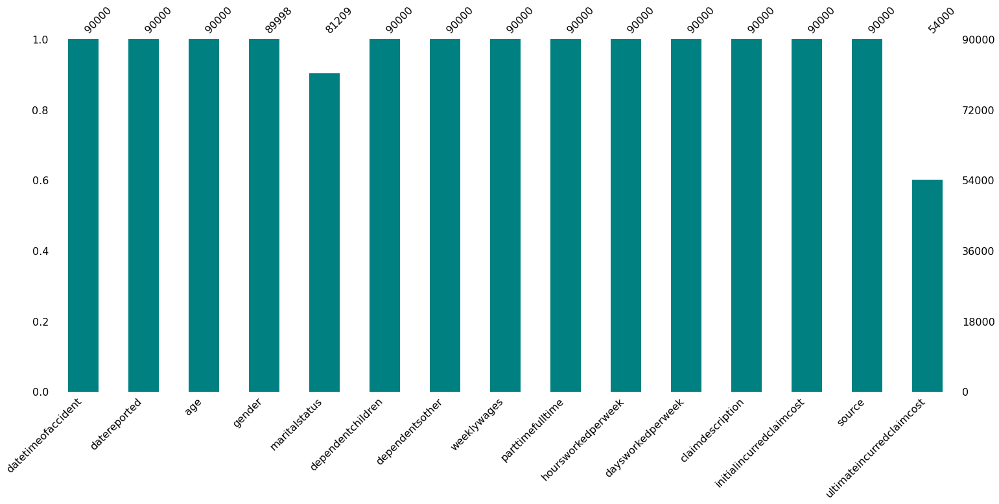

In [22]:
# Bar chart of the missing values
msno.bar(data.sort_values('ultimateincurredclaimcost'), color=(0, 0.5, 0.5))
plt.show()

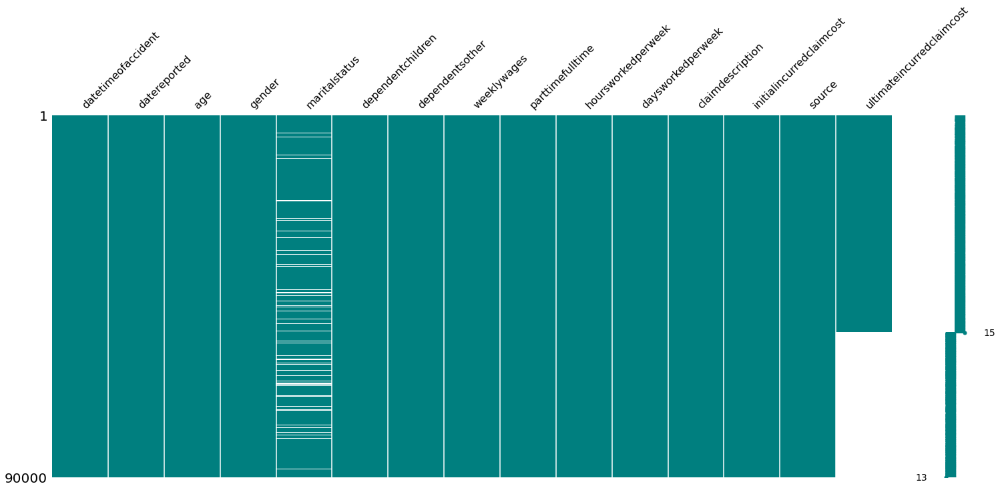

In [23]:
msno.matrix(data.sort_values(by='ultimateincurredclaimcost'), color=(0, 0.5, 0.5))
plt.show()

In [24]:
# we confirm that 100% of the missing ultimate incurred claim cost feature is comming from the kaggle test source
data.loc[data.ultimateincurredclaimcost.isna(), 'source'].value_counts(normalize=True)

kaggle    1.0
Name: source, dtype: float64

The matrix plot indicates how missing values spread between the rows. We note again that for the test set the `UltimateIncurredClaimCost` is missing. The feature `MaritalStatus` is not showing a pattern in missingness. `Gender` is missing in only two cases.

## Imputation

In [25]:
# looking again on the missing values
pd.concat(
    [
     data.isna().sum()[data.isna().sum() != 0],
     (data.isna().sum()[data.isna().sum() != 0] / len(data) * 100).astype(str).str[:6] + '%'
     ],
     axis=1
    ).rename({0: 'count', 1: 'proportion'}, axis=1)

,count,proportion
gender,2,0.0022%
maritalstatus,8791,9.7677%
ultimateincurredclaimcost,36000,40.0%


## `Gender`

In [26]:
# observing the distribution between the genders
pd.DataFrame(
     {'count': data.gender.value_counts(),
      'proportion': (data.gender.value_counts(normalize=True) * 100).astype(str).str[:6] + '%'
     }
)

,count,proportion
M,69566,77.297%
F,20432,22.702%


In [27]:
# impute with the most common observation
data.gender.fillna('M', inplace=True)

For `Gender` we choose to impute the missing elements with the most frequent observation that is `"M"` i.e. male.

In [28]:
# change datatype from object to category
data.gender = data.gender.astype('category')

`MaritalStatus`

In [29]:
# observing the distribution between the marital status
pd.DataFrame(
     {'count': data.maritalstatus.value_counts(),
      'proportion': (data.maritalstatus.value_counts(normalize=True) * 100).astype(str).str[:6] + '%'
     }
)

,count,proportion
S,43674,53.779%
M,37535,46.220%


In [30]:
# group the rows where marital status is missing per gender and number of dependent children
data.loc[data['maritalstatus'].isna(),
         ['gender', 'dependentchildren']] \
    .groupby(['gender', 'dependentchildren']).size().agg({'count': lambda x: x, 'prop':lambda x: x / x.sum(level=0)}
  ).unstack(level=0)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning:

Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().



count      prop
gender dependentchildren                  
F      0                  1729.0  0.985747
       1                    12.0  0.006842
       2                     8.0  0.004561
       3                     4.0  0.002281
       4                     1.0  0.000570
M      0                  6963.0  0.989484
       1                    39.0  0.005542
       2                    20.0  0.002842
       3                    10.0  0.001421
       4                     5.0  0.000711

We can see that where data is missing mainly for males without children. Looking on our data we can see the following distribution:

In [31]:
cols = ['maritalstatus', 'dependentchildren']
data.groupby(cols)[cols].count()

maritalstatus  dependentchildren
maritalstatus dependentchildren                                  
M             0                          32781              32781
              1                           1651               1651
              2                           1982               1982
              3                            822                822
              4                            216                216
              5                             71                 71
              6                             10                 10
              7                              1                  1
              8                              1                  1
              9                              0                  0
S             0                          42940              42940
              1                            380                380
              2                            267                267
              3                             68                 68
              4                             12                 12
              5                              5                  5
              6                              0                  0
              7                              0                  0
              8                              1                  1
              9                              1                  1

In [32]:
queries = ['gender == "F" and dependentchildren == 0',
           'gender == "F" and dependentchildren != 0',
           'gender == "M" and dependentchildren == 0',
           'gender == "M" and dependentchildren != 0']
for query in queries:
    print(query)
    print(data.query(query)['maritalstatus'].value_counts(normalize=True))
    print('\n')

gender == "F" and dependentchildren == 0
S    0.537434
M    0.462566
Name: maritalstatus, dtype: float64


gender == "F" and dependentchildren != 0
M    0.817158
S    0.182842
Name: maritalstatus, dtype: float64


gender == "M" and dependentchildren == 0
S    0.576009
M    0.423991
Name: maritalstatus, dtype: float64


gender == "M" and dependentchildren != 0
M    0.879326
S    0.120674
Name: maritalstatus, dtype: float64




We will use the most frequent observations for imputation, that is

- `S`: single if there is no dependent children
- `M`: married otherwise

In [33]:
condition = (data['maritalstatus'].isna()) & (data['dependentchildren'] == 0)
data.loc[condition, 'maritalstatus'] = 'S'  # single if there is no dependent children
data.loc[~condition, 'maritalstatus'] = 'M'  # married otherwise

In [34]:
# check to see if there remained any missing data
data.isna().sum()

datetimeofaccident               0
datereported                     0
age                              0
gender                           0
maritalstatus                    0
dependentchildren                0
dependentsother                  0
weeklywages                      0
parttimefulltime                 0
hoursworkedperweek               0
daysworkedperweek                0
claimdescription                 0
initialincurredclaimcost         0
source                           0
ultimateincurredclaimcost    36000
dtype: int64

In [35]:
# double checking that ultimate claim is missing only for the kaggle set
data.query('source != "kaggle"').isna().sum()

datetimeofaccident           0
datereported                 0
age                          0
gender                       0
maritalstatus                0
dependentchildren            0
dependentsother              0
weeklywages                  0
parttimefulltime             0
hoursworkedperweek           0
daysworkedperweek            0
claimdescription             0
initialincurredclaimcost     0
source                       0
ultimateincurredclaimcost    0
dtype: int64

## Conclusions

1. There are two kinds of missing data in the dataset
    - represented as nan - for `MaritalStatus` only
    - represented as `U` for *unknown* - for `MaritalStatus` and `Gender`

2. As most of the missing values are represented as `U` we chose to unify their representations as `nan`.
3. We concluded that there is no significant relationship in the missigness of the values that are missing, thus they are missing at random.
4. We used the following imputations:
    - `Gender`: only two missing entries, replaced with most frequent entry (male),
    - `MaritalStatus`: based on the distribution of the data we assumed married status when `DependentChildren > 0`, single otherwise.

# 3.&nbsp;EDA, feature engineering

## 3.1.&nbsp;Date-times

### Separating date and time components

In [36]:
print('Unique time values:')
print(f'\n  DateReported (time): {data["datereported"].dt.time.unique()}')
print(f'\n  DateTimeOfAccident (time): {data["datetimeofaccident"].dt.time.unique()}')
print(f'\n  DateTimeOfAccident (hour): {sorted(list(data["datetimeofaccident"].dt.hour.unique()))}')
print(f'\n  DateTimeOfAccident (hour) - length: {len(data["datetimeofaccident"].dt.hour.unique())}')

Unique time values:

  DateReported (time): [datetime.time(0, 0)]

  DateTimeOfAccident (time): [datetime.time(10, 0) datetime.time(16, 0) datetime.time(9, 0)
 datetime.time(14, 0) datetime.time(13, 0) datetime.time(11, 0)
 datetime.time(15, 0) datetime.time(6, 0) datetime.time(12, 0)
 datetime.time(4, 0) datetime.time(20, 0) datetime.time(8, 0)
 datetime.time(19, 0) datetime.time(0, 0) datetime.time(17, 0)
 datetime.time(7, 0) datetime.time(22, 0) datetime.time(5, 0)
 datetime.time(21, 0) datetime.time(18, 0) datetime.time(1, 0)
 datetime.time(2, 0) datetime.time(3, 0) datetime.time(23, 0)]

  DateTimeOfAccident (hour): [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]

  DateTimeOfAccident (hour) - length: 24


In [37]:
# extract dates from datetime (loosing the time component)
data['reporting_date'] = pd.to_datetime(data.datereported.dt.date)
# drop original column
data.drop('datereported', axis=1, inplace=True)

# datetimeofaccident - from the time component only hour contains information
data['accident_date'] = pd.to_datetime(data.datetimeofaccident.dt.date)
# keep only the hour of accident
data['accident_hour'] = data.datetimeofaccident.dt.hour
# drop original columns
data.drop('datetimeofaccident', axis=1, inplace=True)

In [38]:
fig = px.histogram(
    data, x='accident_hour',
    color='source',
    title='Distribution of claims per the hour of accident')
fig.update_xaxes(
    dtick=1
)
fig.show()

We can see that for `DateReported` the time of the datetime data type columns contain no additional information, and for the `DateTimeOfAccident` column only the hours contain information. Thus, we will convert `DateReported` from `datetime` to `date` and split `DateTimeOfAccident` to `date` and `hour` components. We also note that the time of accident spread across all day including night hours, which indicates that the portfolio of insured workers work multiple shifts.

For further analysis we may be needing the `year`, `month`, `quarter` components, so we extract them for easier future usage.

In [39]:
# DateReported
data['reporting_year'] = data.reporting_date.dt.year
data['reporting_month'] = data.reporting_date.dt.month
data['reporting_quarter'] = np.ceil((data.reporting_month / 3)).astype(int)
data['reporting_day'] = data.reporting_date.dt.day

# AccidentDate
data['accident_year'] = data.accident_date.dt.year
data['accident_month'] = data.accident_date.dt.month
data['accident_quarter'] = np.ceil((data.accident_month / 3)).astype(int)
data['accident_day'] = data.accident_date.dt.day

### Delay in reporting

It may be useful to extract the delay in reporting after the accident has occured. We can measure delay in years, quarters, months, weeks, days. These features will be naturally highly correlated, but they may help to gain a better understanding on the data in a later exploration phase.

In [40]:
# reporting delay in months
data['delay_month'] = ((data.reporting_date - data.accident_date) / np.timedelta64(1, 'M')).astype(int)
# reporting delay in days
data['delay_day'] = (data.reporting_date - data.accident_date).dt.days
# reporting delay in quarters
data['delay_quarter'] = data['delay_month'] // 3
# reporting delay in years
data['delay_year'] = data['delay_month'] // 12
# reporting delay in weeks
data['delay_week'] = data['delay_day'] // 7

### Distribution

In [41]:
data[['accident_date', 'reporting_date']].describe(datetime_is_numeric=True)

,accident_date,reporting_date
count,90000,90000
mean,1996-12-30 12:03:43.679999872,1997-02-07 14:17:44.640000128
min,1988-01-01 00:00:00,1988-01-08 00:00:00
25%,1992-06-24 00:00:00,1992-07-28 00:00:00
50%,1997-01-01 00:00:00,1997-02-11 12:00:00
75%,2001-06-28 00:00:00,2001-08-16 00:00:00
max,2005-12-31 00:00:00,2007-01-07 00:00:00


`accident_date` ranges from `1988` to `2005` so includes `18` full years of data.
`reporting_date` ranges from `1988` to `2007`.

In [42]:
# claims incurred in the beginning (I exclude the latest datetime related columns such as delays in reporting)
data.loc[data.accident_date == data.accident_date.min()].iloc[:, :-14].T

ClaimNumber,WC1700190,WC1661381,WC1845324,WC1853408,WC1691930,WC1890878
age,40,62,26,59,50,45
gender,M,F,M,F,F,F
maritalstatus,M,M,M,M,M,M
dependentchildren,2,3,2,0,0,0
dependentsother,1,1,0,0,0,0
weeklywages,334.9,294.2,193.04,334.9,300.0,48.26
parttimefulltime,F,F,F,F,F,F
hoursworkedperweek,30.0,38.0,40.0,40.0,32.0,31.75
daysworkedperweek,5,5,5,5,5,5
claimdescription,SOLVENT FLICKED INTO EYE CORNEAL ABRASION RIGH...,FELL AGAINST FORKLIFT LACERATED LEG LACERATED ...,SLIPPED OFF BUS SPRAINED ANKLE KNEE AND CUT LE...,STRUCK KNIFE SLIPPED CUT FINGER LACERATED RIGH...,LIFTING TABLES STRAIN LUMBAR SPINE INJURY,STRUCK FALLING DOOR PULLED MUSCLE IN FOREARM


In [43]:
# claims reported last
data.loc[data.accident_date == data.accident_date.max()].iloc[:, :-14].T

ClaimNumber,WC9645211
age,17
gender,M
maritalstatus,M
dependentchildren,0
dependentsother,0
weeklywages,335.38
parttimefulltime,F
hoursworkedperweek,38.0
daysworkedperweek,5
claimdescription,SLIPPED SHOWER FLOOR SOFT TISSUE INJURY BACK


In [44]:
# counting observations per accident year
data.groupby(data['accident_year']).size()

accident_year
1988    5000
1989    5000
1990    5000
1991    5000
1992    5000
1993    5000
1994    5000
1995    5000
1996    5000
1997    5000
1998    5000
1999    5000
2000    5000
2001    5000
2002    5000
2003    5000
2004    5000
2005    5000
dtype: int64

There are `5000` observations per each accident year.

In [45]:
fig = px.bar(
    data.groupby(['source', 'reporting_year']).size().reset_index().rename({0: 'count'}, axis=1),
    x='reporting_year',
    y='count',
    color='source',
    title='Number of observations per reporting date')
fig.update_xaxes(
    dtick=1
)
fig.show()

In [46]:
# there is one observation with reporting year 2007
# the delay in reporting is more that 1 years for this case!
data.query('reporting_year == 2007').iloc[:, :-14].T

ClaimNumber,WC9895400
age,54
gender,F
maritalstatus,M
dependentchildren,0
dependentsother,0
weeklywages,500.0
parttimefulltime,F
hoursworkedperweek,38.0
daysworkedperweek,5
claimdescription,STRUCK GLASS ABRASION LEFT EYE


The number of observations per reporting year is even, except the beginning and the end of the time series. This is due to the nature of claims regarding the delay in reporting.

In [47]:
col = 'delay_month'
delay = data[col].value_counts(normalize=True).sort_index()
print((pd.concat([delay, delay.cumsum().rename('cumulative_%')], axis=1)*100).iloc[:5].astype(int).astype(str) +' %')
fig = px.bar(delay.cumsum().rename('cumulative_%'), title=f'Distribution of records per {col} in %')
fig.show()

  delay_month cumulative_%
0        64 %         64 %
1        21 %         85 %
2         6 %         92 %
3         2 %         94 %
4         1 %         96 %


About 2/3 of the claims are reported in the first month, and about `~95%` reported in the first three months.

In [48]:
col = 'delay_week'
delay = data[col].value_counts(normalize=True).sort_index()
print((pd.concat([delay, delay.cumsum().rename('cumulative_%')], axis=1)*100).iloc[:5].astype(int).astype(str) +' %')
fig = px.bar(delay.cumsum().rename('cumulative_%'), title=f'Distribution of records per {col} in %')
fig.show()

  delay_week cumulative_%
0        3 %          3 %
1       19 %         23 %
2       20 %         44 %
3       14 %         59 %
4        9 %         68 %


We note that claims are reported usually not reported in week of occurance.

In [49]:
col = 'delay_day'
delay = data[col].value_counts(normalize=True).sort_index()
print((pd.concat([delay, delay.cumsum().rename('cumulative_%')], axis=1)*100).iloc[:5].astype(int).astype(str) +' %')
fig = px.line(delay.cumsum().rename('cumulative_%'), title=f'Distribution of records per {col} in %')
fig.show()

  delay_day cumulative_%
0       0 %          0 %
1       0 %          0 %
2       0 %          0 %
3       0 %          1 %
4       0 %          1 %


### Conclusions

## Summary

1. There are two features that has datetime data types:
    - `datetimeofaccident`: from time information only hour is relevant;
    - `datetimereported`: no real time information, only date is relevant.

2. `accident_date` ranges from `1988` to `2005` so includes `18` full years of data. `reporting_date` ranges from `1988` to `2007`.
3. We separated the components of datetime separately for the two features. As a result we created the following features.
4. From `datetimeofaccident`:
    - `accident_date`: date of accident excluding time from `datetimeofaccident`;
    - `accident_year`: year of accident;
    - `accident_quarter`: quarter of accident;
    - `accident_month`: month of accident;
    - `accident_day`: day of accident.
5. From `datetimereported`:
    - `reporting_date`: date of reporting excluding time from `datetimereported`;
    - `reporting_year`, `reporting_quarter`, `reporting_month`, `reporting_day`: similarly to `accident_date`.
6. We calculated the delay in reporting using several time periods as measures to engineer the following features:
    - `delay_year`: delay in reporting in years;
    - `delay_quarter`, `delay_month`, `delay_week`, `delay_day`: similarly to `delay_year`.
7. Most claims incurred during typical business hours but there are some accident happined during night which indicates that there may be 2-3 shifts in the company.
8. About 2/3 of the claims are reported in the first month, and about `~95%` reported in the first three months.

We note that not all of these newly created variables will be used in the modelling phase as they are highly correlated.

## 3.2.&nbsp;Claim number

### Uniqueness

We examine whether they are truly a unique identifier.

In [50]:
data.index.is_unique

True

### Structure

In [51]:
print(f'Sample of ClaimNumber ids:\n {data.sample(10).index}\n\n'
      f'The length of ClaimNumber ids: {set(data.index.str.len())}\n\n'
      f'The first two characters are WC: {data.index.str[:2].unique()}\n\n'
      f'{data.index.str[2:].astype(int).unique()}\n\n'
      f'min value: {min(data.index.str[2:].astype(int))}\n'
      f'max value: {max(data.index.str[2:].astype(int))}')

Sample of ClaimNumber ids:
 Index(['WC4982601', 'WC7071211', 'WC1764875', 'WC8728183', 'WC8937850',
       'WC8943576', 'WC3143502', 'WC6114913', 'WC4295480', 'WC9368846'],
      dtype='object', name='ClaimNumber')

The length of ClaimNumber ids: {9}

The first two characters are WC: Index(['WC'], dtype='object', name='ClaimNumber')

Int64Index([8145235, 2005111, 6899143, 5502023, 4785156, 7296554, 9274579,
            7580073, 5186430, 8599800,
            ...
            3485403, 7426219, 6263025, 4447156, 7006507, 9370727, 8396269,
            3609528, 5038565, 2542601],
           dtype='int64', name='ClaimNumber', length=90000)

min value: 1592889
max value: 9999961


In [52]:
# we extract the claim_number and store it in a feature
data.insert(0, 'claim_number', data.index.str[2:])
data.claim_number = pd.to_numeric(data.claim_number)

In [53]:
col = 'date'
fig = px.line(
    data.groupby(f'accident_{col}').agg(dict(claim_number='median')),
    title=f'Median claim number per {col} of accident')
fig.show()

We observe that the claim number shifts annually

In [54]:
col = 'year'
fig = px.line(
    data.groupby(f'accident_{col}').agg(dict(claim_number='median')),
    title=f'Median claim number per {col} of accident')
fig.show()

Aggregating annually the trend is even more obvious.

### Conclusions

Regarding the index `ClaimNumber` we note the following:

1. `ClaimNumber` is indeed a unique identifier.
2. The length of the IDs are `9` always starting with `WC` and ending in `7` digits.
3. The digits component of the `ClaimNumber` increases with time and as such can be an important so we created a feature called `claim_number` containing only the digits and kept the original `ClaimNumber` as index.

## 3.3.&nbsp;Categorical features

In [55]:
cols_categorical = 'gender', 'maritalstatus', 'parttimefulltime'
cols_categorical

('gender', 'maritalstatus', 'parttimefulltime')

### Distribution

In [56]:
col, title = 'parttimefulltime', 'Distribution of categorical features'
fig = make_subplots(rows=1, cols=3)
fig.add_trace(
    go.Histogram(x=data['parttimefulltime'], name='Part-time'),
    row=1, col=1
)

fig.add_trace(
    go.Histogram(x=data['gender'], name='Gender'),
    row=1, col=2
)

fig.add_trace(
    go.Histogram(x=data['maritalstatus'], name='Marital status'),
    row=1, col=3
)


fig.update_layout(height=600, width=800, title_text=title, showlegend=True)
fig.show()

In [57]:
for col in cols_categorical:
    print(data[col].value_counts(normalize=True))

M    0.772978
F    0.227022
Name: gender, dtype: float64
M    0.903422
S    0.096578
Name: maritalstatus, dtype: float64
F    0.910511
P    0.089489
Name: parttimefulltime, dtype: float64


In [58]:
data.groupby(['gender', 'maritalstatus', 'parttimefulltime']).size().reset_index(name='count').assign(proportion=lambda x: 100 * x['count'] / len(data))

,gender,maritalstatus,parttimefulltime,count,proportion
0,F,M,F,14592,16.213333
1,F,M,P,4111,4.567778
2,F,S,F,1326,1.473333
3,F,S,P,403,0.447778
4,M,M,F,59443,66.047778
5,M,M,P,3162,3.513333
6,M,S,F,6585,7.316667
7,M,S,P,378,0.420000


### Conclusions

- `gender`: `77%+` of the population is male
- `maritalstatus`: `90%+` of the population is married
- `parttimefulltime`: `91%+` of the population is full-time employee
- The proportion of full-time married males and females are `~66%` and `~16%` respectively.
- From the single status full-time workers the proportion of women (`~1.5%`) is smaller than the proportion of men (`~7.3%`).
- Part-time married workers are rather women (`~4.6%`), the men are (`~3.5%`).
- The distribution of single part-time workers is roughly even between the genders (`~0.4%`).


## 3.4.&nbsp;Numerical features

In [59]:
'age', 'dependentchildren', 'dependentsother', 'weeklywages', 'hoursworkedperweek', 'daysworkedperweek'

('age',
 'dependentchildren',
 'dependentsother',
 'weeklywages',
 'hoursworkedperweek',
 'daysworkedperweek')

### Age

In [60]:
col, title = 'age', 'Distribution of age'
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Histogram(x=data[col], name=col),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=data[col], name=title),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=False)
fig.show()

In [61]:
fig = px.box(data, x='accident_year', y='age', title='Age per accident year')
fig.show()

The median age increased from late 1980s 30 to around 35 in the mid 2000s.

In [62]:
# age above 65
data.loc[data[col] > 65].iloc[: , :-14].T

ClaimNumber,WC4954252,WC2226307,WC1898981,WC5357822,WC9574515,WC1980858,WC9688383,WC7325369,WC5080122,WC9863188,...,WC9951620,WC1852723,WC2681407,WC9361298,WC9374951,WC4167934,WC6080043,WC2011934,WC9547569,WC9665638
claim_number,4954252,2226307,1898981,5357822,9574515,1980858,9688383,7325369,5080122,9863188,...,9951620,1852723,2681407,9361298,9374951,4167934,6080043,2011934,9547569,9665638
age,67,67,72,66,75,68,76,71,66,66,...,71,70,66,69,70,69,67,69,66,66
gender,M,M,M,M,M,M,M,M,M,M,...,M,M,M,M,F,M,M,M,M,M
maritalstatus,S,M,M,M,M,M,M,M,M,S,...,M,M,M,S,S,S,M,M,M,M
dependentchildren,0,0,0,3,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
dependentsother,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
weeklywages,453.0,200.0,139.84,703.17,300.0,299.6,945.67,200.0,200.0,1012.5,...,500.0,300.0,272.16,668.86,342.06,631.28,620.0,766.52,650.0,1700.0
parttimefulltime,F,F,F,F,F,F,F,P,F,F,...,F,F,P,F,F,F,F,F,F,F
hoursworkedperweek,8.0,38.0,37.5,38.0,38.0,40.0,42.0,7.0,38.0,56.0,...,30.0,38.0,29.0,38.0,24.5,42.0,40.0,45.0,38.0,48.0
daysworkedperweek,3,5,5,5,5,5,5,1,5,5,...,5,5,5,4,5,5,5,5,5,6


In [63]:
# age below 18
data.loc[data[col] < 18].iloc[: , :-14].T

ClaimNumber,WC5549096,WC7455291,WC9292233,WC9114830,WC2170662,WC3923732,WC2406079,WC8514282,WC8807317,WC6402657,...,WC9973124,WC1603896,WC7801200,WC8229026,WC5582148,WC6078796,WC8521481,WC3797733,WC2789012,WC8372390
claim_number,5549096,7455291,9292233,9114830,2170662,3923732,2406079,8514282,8807317,6402657,...,9973124,1603896,7801200,8229026,5582148,6078796,8521481,3797733,2789012,8372390
age,16,16,17,17,17,17,17,14,16,17,...,17,15,16,17,17,17,14,16,16,13
gender,M,F,M,M,F,M,M,M,F,M,...,M,F,M,F,M,M,F,M,F,F
maritalstatus,M,M,M,M,M,M,M,M,S,M,...,M,M,M,M,M,M,M,M,M,M
dependentchildren,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
dependentsother,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
weeklywages,200.0,200.0,147.54,500.0,198.17,181.6,186.0,152.15,78.68,331.4,...,325.98,44.0,200.0,58.53,200.0,200.0,134.46,175.18,200.0,250.0
parttimefulltime,F,P,P,F,F,F,F,F,P,P,...,F,P,F,P,F,F,P,F,F,P
hoursworkedperweek,38.0,20.0,20.0,40.0,40.0,38.0,38.0,38.0,15.0,8.0,...,40.0,28.0,38.0,6.0,38.0,40.0,8.0,38.0,38.0,30.0
daysworkedperweek,5,5,4,5,5,5,5,5,3,2,...,5,5,5,4,5,5,5,5,5,5


In [64]:
# what proportion of the employees fall between the age 18 and 65?
len(data.query('age > 17 and age < 55')) / len(data)

0.9020222222222222

We observe that the distribution of age is out-of-ordinary.
- One the one end, we have around `~3000` employees that are below the age of `18`. We do not know the origin of the data, but the organisers are from Australia and Singapore. In Singapore according to the [Singapore Government Agency Website](https://www.mom.gov.sg/employment-practices/young-persons-and-children) it is possible under some conditions for children starting from the age of `13` to be employed.
- On the other end of the distribution, there are `~300` employees above the age of `65`, the doyen being `81`-years old. It is interesting, but could be reasonable.

Due to the lack of information we decided not to change the observations.

### DependentChildren

In [65]:
col, title = 'dependentchildren', 'Distribution of dependent children'
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Histogram(x=data[col], name=col),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=data[col], name=title),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=False)
fig.show()

In [66]:
# number of dependent children above 5
data.loc[data[col] > 5].iloc[: , :-14].T

ClaimNumber,WC2646173,WC2637534,WC1677020,WC2920588,WC9690138,WC2930470,WC2403056,WC9016054,WC1981653,WC2861541,WC9296341,WC5061182,WC9779919,WC2851955
claim_number,2646173,2637534,1677020,2920588,9690138,2930470,2403056,9016054,1981653,2861541,9296341,5061182,9779919,2851955
age,30,40,28,41,27,43,32,22,39,30,52,32,37,27
gender,M,M,F,F,F,M,M,M,F,M,F,M,M,M
maritalstatus,M,M,M,M,M,M,M,M,M,M,M,M,M,M
dependentchildren,6,6,7,6,8,6,6,9,6,6,8,6,6,6
dependentsother,0,0,0,0,0,0,0,0,0,0,1,0,0,0
weeklywages,600.0,663.46,200.0,100.0,500.0,800.0,528.0,434.8,260.64,563.6,500.0,643.0,1800.0,760.0
parttimefulltime,F,F,P,F,F,F,F,F,P,F,P,F,F,F
hoursworkedperweek,40.0,40.0,30.0,40.0,40.0,40.0,38.0,40.0,30.0,38.0,29.0,37.5,84.0,53.0
daysworkedperweek,5,5,5,5,5,5,5,6,5,5,4,5,5,3


In [67]:
data[col].value_counts().sort_index()

0    84413
1     2082
2     2277
3      904
4      234
5       76
6       10
7        1
8        2
9        1
Name: dependentchildren, dtype: int64

There are about `14` observations where above `5` children. We don't have enough information to decide whether this is incorrect, so we keep it as is.

### DependentsOther

In [68]:
col, title = 'dependentsother', 'Distribution of dependents other than children'
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Histogram(x=data[col], name=col),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=data[col], name=title),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=False)
fig.show()

In [69]:
# number of other dependent above 2
data.loc[data[col] > 2].iloc[: , :-14].T

ClaimNumber,WC9257206,WC2180589,WC1714989,WC2841692,WC2401290,WC2635189,WC7795238,WC7405150,WC2031685,WC1819517,WC3840899,WC7926799,WC2189045,WC2460927
claim_number,9257206,2180589,1714989,2841692,2401290,2635189,7795238,7405150,2031685,1819517,3840899,7926799,2189045,2460927
age,66,19,35,60,19,31,36,55,42,34,44,44,34,49
gender,F,F,M,F,F,M,M,M,M,M,M,M,M,F
maritalstatus,M,M,M,M,M,M,M,M,M,M,M,M,M,M
dependentchildren,0,0,3,4,0,3,0,0,2,2,0,0,1,0
dependentsother,4,3,3,3,5,3,3,3,3,3,3,3,3,5
weeklywages,1615.25,257.08,471.7,328.63,229.0,573.31,673.0,1442.31,610.54,307.0,371.5,672.98,316.5,263.5
parttimefulltime,F,F,F,F,F,F,F,F,F,F,F,F,F,F
hoursworkedperweek,40.0,40.0,40.0,38.0,33.5,42.0,38.0,40.0,40.0,40.0,40.0,38.0,40.0,32.5
daysworkedperweek,5,5,5,5,5,3,5,5,5,5,5,5,5,5


In [70]:
data[col].value_counts().sort_index()

0    89188
1      760
2       38
3       11
4        1
5        2
Name: dependentsother, dtype: int64

There are about `14` observations where above `2` other dependts. We don't have enough information to decide whether this is incorrect, so we keep it as is (we also don't know the definition of other dependents).

### HoursWorkedPerWeek

In [71]:
col, title = 'hoursworkedperweek', 'Distribution of hours worked per week'
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Histogram(x=data[col], name=col),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=data[col], name=title),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=False)
fig.show()

The plots are very strange, which suggest that there are lots of observations with erroneous records. The maximum hours in a week is `168`, but this is just a theoretical upper limit of this feature. We should choose a lower limit, for example a person who would work all days of a week one full shift would work for 7*8 hours.

In [72]:
# we check how many erroneous observations there might be
query_list = ['hoursworkedperweek > 5*8',
              'hoursworkedperweek > 7*8',
              'hoursworkedperweek > 5*24',
              'hoursworkedperweek > 7*24']
for query in query_list:
    print(f'{query}: {len(data.query(query))}')

hoursworkedperweek > 5*8: 4128
hoursworkedperweek > 7*8: 1039
hoursworkedperweek > 5*24: 62
hoursworkedperweek > 7*24: 60


In [73]:
data.query('hoursworkedperweek > 12*5').sample(5)

,claim_number,age,gender,maritalstatus,dependentchildren,dependentsother,weeklywages,parttimefulltime,hoursworkedperweek,daysworkedperweek,...,reporting_day,accident_year,accident_month,accident_quarter,accident_day,delay_month,delay_day,delay_quarter,delay_year,delay_week
ClaimNumber,,,,,,,,,,,,,,,,,,,,,
WC8487178,8487178,55,M,M,0,0,2345.75,F,73.0,7,...,21,2002,6,2,9,0,12,0,0,1
WC5021144,5021144,32,M,M,0,0,200.00,P,83.0,3,...,23,1995,10,4,20,1,34,0,0,4
WC9914056,9914056,31,M,S,0,0,1445.60,F,70.0,5,...,8,2005,7,3,8,1,31,0,0,4
WC2483351,2483351,19,M,M,0,0,280.00,F,70.0,5,...,13,1989,5,2,15,0,29,0,0,4
WC9459357,9459357,24,M,M,0,0,580.68,F,77.0,7,...,28,2004,1,1,8,0,20,0,0,2


In [74]:
# limit the feature at 7*8 = 56 hours maximum
data.hoursworkedperweek = data.hoursworkedperweek.clip(lower=0, upper=7*8)

In [75]:
# we check the other end of the distribution
query_list = ['hoursworkedperweek < 1',
              'hoursworkedperweek < 2',
              'hoursworkedperweek < 5',
              'hoursworkedperweek < 9']
for query in query_list:
    print(f'{query}: {len(data.query(query))}')

hoursworkedperweek < 1: 41
hoursworkedperweek < 2: 92
hoursworkedperweek < 5: 206
hoursworkedperweek < 9: 705


In [76]:
data.query('hoursworkedperweek < 2').sample(5)

,claim_number,age,gender,maritalstatus,dependentchildren,dependentsother,weeklywages,parttimefulltime,hoursworkedperweek,daysworkedperweek,...,reporting_day,accident_year,accident_month,accident_quarter,accident_day,delay_month,delay_day,delay_quarter,delay_year,delay_week
ClaimNumber,,,,,,,,,,,,,,,,,,,,,
WC5166707,5166707,18,M,S,0,0,1.00,F,1.0,1,...,20,1995,9,3,1,5,172,1,0,24
WC5308539,5308539,23,M,S,0,0,1.00,P,1.0,1,...,20,1995,5,2,29,0,22,0,0,3
WC4914457,4914457,33,M,S,0,0,1.00,F,1.0,1,...,4,1995,8,3,4,1,31,0,0,4
WC5264856,5264856,25,F,M,0,0,238.26,F,1.0,5,...,14,1995,5,2,6,1,39,0,0,5
WC4593563,4593563,40,F,M,0,0,224.00,P,1.0,2,...,26,1994,11,4,10,0,16,0,0,2


We don't have sufficient information to decide whether these are incorrect or not. They can be correct for example if the employee was on vacation and worked limited time or the worker is a part-time employee, etc. For this reason we do not modify the distribution further.

In [77]:
col, title = 'hoursworkedperweek', 'Distribution of hours worked per week'
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Histogram(x=data[col], name=col),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=data[col], name=title),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=False)
fig.show()

The above plots show the distribution after data correction.

In [78]:
# 99% of the population worked between 10-56 hours
len(data.query('hoursworkedperweek > 9 and hoursworkedperweek < 57')) / len(data)

0.9913666666666666

### DaysWorkedPerWeek

In [79]:
col, title = 'daysworkedperweek', 'Distribution of days worked per week'
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Histogram(x=data[col], name=col),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=data[col], name=title),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=False)
fig.show()

In [80]:
pd.DataFrame(
    {'count': data[col].value_counts().sort_index(),
     'proportion': data[col].value_counts(normalize=True).sort_index() *100}
)

,count,proportion
1,312,0.346667
2,817,0.907778
3,2321,2.578889
4,2454,2.726667
5,82091,91.212222
6,1457,1.618889
7,548,0.608889


Most employees worked 5 days a week which is normal. There range is correct, although we observe that there are no employees who worked zero days, which contradicts our assumption in the previous point where we observed that there are cases for which HoursWorkedPerWeek is nil.

In [81]:
data.query('hoursworkedperweek == 0').daysworkedperweek.value_counts()

5    24
1     8
2     3
3     3
6     1
4     1
Name: daysworkedperweek, dtype: int64

It seems unreasonable to suffer a work related an accident when not working. As `hoursworkedperweek` and `daysworkedperweek` contradicts in the above cases I decided to replace the `hoursworkedperweek` values for these observations.

In [82]:
data.query('hoursworkedperweek != 0').groupby('daysworkedperweek').agg({'hoursworkedperweek': ['mean', 'median']})

hoursworkedperweek       
                                mean median
daysworkedperweek                          
1                           9.366579    7.4
2                          13.933624   12.0
3                          22.247002   20.0
4                          28.989539   30.0
5                          38.132959   38.0
6                          47.124691   50.0
7                          50.721715   56.0

In [83]:
mapping = data.query('hoursworkedperweek != 0').groupby('daysworkedperweek').agg({'hoursworkedperweek': 'median'}).to_dict()['hoursworkedperweek']
print(mapping)
pd.concat([data.loc[data['hoursworkedperweek'] == 0, 'daysworkedperweek'], data.loc[data['hoursworkedperweek'] == 0, 'daysworkedperweek'].map(mapping)], axis=1).sample(5)

{1: 7.4, 2: 12.0, 3: 20.0, 4: 30.0, 5: 38.0, 6: 50.0, 7: 56.0}


,daysworkedperweek,daysworkedperweek
ClaimNumber,,
WC9169196,1,7.4
WC5298558,1,7.4
WC2616050,5,38.0
WC4839221,4,30.0
WC4127407,1,7.4


In [84]:
# replacing the nil hoursworkedperweek values with the median hoursworkedperweek values observed based on the daysworkedperweek
data.loc[data['hoursworkedperweek'] == 0, 'hoursworkedperweek'] = data.loc[data['hoursworkedperweek'] == 0, 'daysworkedperweek'].map(mapping)

In [85]:
data.query('hoursworkedperweek == 0')

,claim_number,age,gender,maritalstatus,dependentchildren,dependentsother,weeklywages,parttimefulltime,hoursworkedperweek,daysworkedperweek,...,reporting_day,accident_year,accident_month,accident_quarter,accident_day,delay_month,delay_day,delay_quarter,delay_year,delay_week
ClaimNumber,,,,,,,,,,,,,,,,,,,,,


### WeeklyWages

In [86]:
col, title = 'weeklywages', 'Distribution of weeklywages'
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Histogram(x=data[col], name=col),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=data[col], name=title),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=False)
fig.show()

We do not know the currency, however we can immediately see two spikes that may suggests data error. If they would be correct than that would mean that significant number of employees had the same salary.

As we have 18 years of data, we need to take into account the years as well.

In [87]:
fig = px.box(data, x='accident_year', y='weeklywages', title='Weekly wages per accident year')
fig.show()

In [88]:
fig = px.line(
    data.groupby('accident_year').agg({'weeklywages': 'median'}),
    title='Median weekly wages per accident year')
fig.show()

There is an apparent fall in the median weekly wages between 1994 and 2000. Interestingly, the median weekly wage does not change during this period. This could correspond to the observation from the previous plot where we noticed that many employees had the same salaries. The cause of this is unknow, but it might have relation with [the great recession of Australi in the early 1990s](https://en.wikipedia.org/wiki/Early_1990s_recession_in_Australia).

In [89]:
# unique salaries between 1996-2000
data.query('accident_year > 1995 and accident_year < 2001').weeklywages.value_counts(normalize=True)

200.00    0.49288
500.00    0.01124
600.00    0.00608
400.00    0.00468
728.40    0.00380
           ...   
219.51    0.00004
217.65    0.00004
279.96    0.00004
648.61    0.00004
451.83    0.00004
Name: weeklywages, Length: 4736, dtype: float64

Between 1996-2000 50% of the workers were employed on a fix `CU 200` weekly wage.

In [90]:
fig = px.scatter(
    data,
    x='weeklywages',
    y='ultimateincurredclaimcost',
    color='accident_year',
    title='Weekly wages vs Ultimate Claims')
fig.show()

In [91]:
potential_outlier = data[data.weeklywages == 390].index[data[data.weeklywages == 390].ultimateincurredclaimcost.argmax()]
data.loc[potential_outlier]

claim_number                                                     9916019
age                                                                   51
gender                                                                 F
maritalstatus                                                          M
dependentchildren                                                      0
dependentsother                                                        0
weeklywages                                                        390.0
parttimefulltime                                                       F
hoursworkedperweek                                                  40.0
daysworkedperweek                                                      5
claimdescription             SLIPPED ON WET FLOOR FRACTURED BASE OF HAND
initialincurredclaimcost                                           43000
source                                                              data
ultimateincurredclaimcost                          

There is one apparent outlier (claim id `WC9916019`) in the population who had CU 390 weekly wage and about CU 4 million ultimate claim.

In [92]:
data.loc[potential_outlier, 'ultimateincurredclaimcost'] = data.loc[potential_outlier, 'ultimateincurredclaimcost'] / 10

In [93]:
fig = px.scatter(
    data,
    x='weeklywages',
    y='ultimateincurredclaimcost',
    color='accident_year',
    title='Weekly wages vs Ultimate Claims')
fig.show()

The above plot shows the scatter-plot after correcting the outlier.

## 3.5.&nbsp;Correlation matrix

In [94]:
cols = ['ultimateincurredclaimcost', 'initialincurredclaimcost', 
        'weeklywages', 'hoursworkedperweek', 'daysworkedperweek',
        'dependentchildren', 'dependentsother', 'age',
        'claim_number', 
        'accident_year', 'reporting_year', 'accident_hour', 'delay_week']
fig = px.imshow(data[cols].corr(), text_auto=True, aspect="auto", title='Correlation matrix as heatmap')
fig.show()

The correlation between the target and the dependent numerical variables is almost zero for all cases except for the following:
- `InitialIncurredClaimCost`: correlation is about `0.5` - highest correlation with the target
- `WeeklyWages`: correlation is about `.18`
- `ClaimNumber`, `AccidentYear`, `ReportingYear`: correlation is around about `.18`, but all these variables contain similar information
- `Age`: correlation is around `.12`, high correlation with the date-related features.

## 3.6.&nbsp;ClaimDescription

### Corpus

In [95]:
# keep only claim numbers and original claim description, store in in a new df called corpus
corpus = pd.DataFrame(
    {'source': data['source'].values,
     'ClaimDescription': data['claimdescription'].values
     },    
    index=data.index
)

In [96]:
# lowercase all characters, strip trailing whitespace
corpus['claim_description'] = corpus.ClaimDescription.str.lower().str.strip()

# find special characters
regex = r'[^A-Za-z0-9\s]+' # match a string of characters that are not a letters or numbers
print(f'Special characters:\n{corpus.loc[corpus.claim_description.str.contains(regex, regex=True), "claim_description"]}')
# # remove special characters
# # decided not to exclude special characters for now
# corpus.claim_description = corpus.claim_description.map(lambda x: re.sub(regex, '', x))
# print(f'Special characters:\n{corpus.loc[corpus.claim_description.str.contains(regex, regex=True), "claim_description"]}')

# character length
corpus['char_len'] = corpus.claim_description.apply(len)
# count the number of words
corpus['word_count'] = corpus.claim_description.str.split(' ').apply(len)
# count the number of unique words
corpus['word_count_unique'] = corpus.claim_description.str.split(' ').apply(set).apply(len)
# create tokens (words)
corpus['tokens'] = corpus.claim_description.apply(word_tokenize)
# count the number of tokens
corpus['token_count'] = corpus.tokens.apply(len)
# count the number of unique words
corpus['token_count_unique'] = corpus.tokens.apply(set).apply(len)

Special characters:
ClaimNumber
WC6543061    vacuuming motor vehicle = going home grazing s...
WC7315558    caught �� bar and mould soft tissue injury rig...
WC3317064       caught �� bar and slipped laceration left hand
Name: claim_description, dtype: object


In [97]:
corpus.sample(3)

,source,ClaimDescription,claim_description,char_len,word_count,word_count_unique,tokens,token_count,token_count_unique
ClaimNumber,,,,,,,,,
WC4613007,kaggle,TRIPPED DOWN STAIRS KNEE ANKLE,tripped down stairs knee ankle,30,5,5,"[tripped, down, stairs, knee, ankle]",5,5
WC9145412,data,SPLIT ACID BURN TO LEFT FOREARM BURN,split acid burn to left forearm burn,36,7,6,"[split, acid, burn, to, left, forearm, burn]",7,6
WC3701253,data,STRUCK STEEL BEAM FOREIGN OBJECT RIGHT EYE,struck steel beam foreign object right eye,42,7,7,"[struck, steel, beam, foreign, object, right, ...",7,7


### Dictionary

We only have observed targets for the training data set, so we will only use this to build a dictionary.

In [98]:
# create dictionary
dictionary = Counter(word_tokenize(' '.join(corpus.query('source == "data"').claim_description)))
print('Number of unique tokens:', len(set(dictionary.keys())))

Number of unique tokens: 3728


In [99]:
# check random sample of size n
n = 10
df = pd.DataFrame(dictionary.most_common(), columns=['token', 'count']).sample(n)
fig = px.bar(df, y='token', x='count', title=f'{n} random elements')
fig.show()

In [100]:
# check top n most frequent tokens
n = 10
df = pd.DataFrame(dictionary.most_common(), columns=['token', 'count']).iloc[:n]
fig = px.bar(df, y='token', x='count', title=f'{n} most frequent elements')
fig.show()

In [101]:
# check bottom n least frequent tokens
n = 10
df = pd.DataFrame(dictionary.most_common(), columns=['token', 'count']).iloc[-n:]
fig = px.bar(df, y='token', x='count', title=f'{n} least frequent elements')
fig.show()

In [102]:
# check an example of the longest sequence of tokens
corpus.loc[corpus.token_count.nlargest(1).index].claim_description.squeeze()

'sudden stop of trolley two fractures nose and cut to lip and chip tooth'

In [103]:
# check examples of the shortest sequence of tokens
corpus.loc[corpus.token_count.nsmallest(10).index].claim_description

ClaimNumber
WC7174688    grinding
WC6865159    grinding
WC4573213    grinding
WC4202911        neck
WC4068333    grinding
WC5529981    drilling
WC5382229        back
WC4791002        back
WC3972332    grinding
WC6869363        back
Name: claim_description, dtype: object

### Vocabulary

We need to update the dictionary with position markers.

1. `<PAD>` (padding): used as filler symbols for shorter sequences (see later).
2. `<BOS>` (beginning-of-sequence): indicates the start of the sequence.
3. `<EOS>` (end-of-sequence): indicates the end of the sequence.
4. `<UNK>` (unknown): tokens that fall out of the vocabulary are replaced with this.

In [104]:
# update dictionary
# key=token, value=number-of-occurences
dictionary.update(
    {'<PAD>': 0,
     '<BOS>': 0,
     '<EOS>': 0,
     '<UNK>': 0}
)

In [105]:
# create a vocabulary, where we enumerate the keys in the dictionary
# key=token, value=index-where-the-token-lies-in-the-dictionary
vocabulary = dict(zip(dictionary, range(len(dictionary))))

In [106]:
# test it on an outside word 
vocabulary.get('megszentségteleníthetetlenségeskedéseitekért', '<UNK>')

'<UNK>'

In [107]:
# test it on an inside word
find_token = 'finger'
print(f'The token {find_token} is observed {dictionary[find_token]} times and is the {vocabulary[find_token]}-th element of the vocabulary.')

The token finger is observed 8584 times and is the 37-th element of the vocabulary.


In [108]:
# test it on a possible miss-spelled, in-side word
# test it on an inside word
find_token = 'lifting'
print(f'The token {find_token} is observed {dictionary[find_token]} times and is the {vocabulary[find_token]}-th element of the vocabulary.')

The token lifting is observed 8300 times and is the 0-th element of the vocabulary.


In [109]:
# test it on a position marker
# they should occur 0-times as they were not counted yet
find_token = '<BOS>'
print(f'The token {find_token} is observed {dictionary[find_token]} times and is the {vocabulary[find_token]}-th element of the vocabulary.')

The token <BOS> is observed 0 times and is the 3729-th element of the vocabulary.


### Encoding

In [110]:
def encode_tokens(tokens: List[str], vocabulary: dict) -> List[int]:
    """ encode tokens based on vocabulary """
    encoding = [vocabulary.get(token, vocabulary['<UNK>'])for token in tokens]
    return [vocabulary['<BOS>']] + encoding + [vocabulary['<EOS>']]

In [111]:
# see an example of the tokenisation and the encoding
tokens = corpus.sample(1)
print(tokens.index)
tokens = tokens["tokens"].squeeze()
print(f"tokens: {['<BOS>'] + tokens + ['<EOS>']}")
print(f'encoding: {encode_tokens(tokens, vocabulary)}')

Index(['WC2294273'], dtype='object', name='ClaimNumber')
tokens: ['<BOS>', 'motor', 'vehicle', 'collision', 'during', 'work', 'back', 'strain', '<EOS>']
encoding: [3729, 206, 333, 755, 751, 143, 23, 24, 3730]


In [112]:
# get a glimpse on the corpus dataframe
corpus['encoded_tokens'] = corpus.tokens.apply(lambda x: encode_tokens(x, vocabulary))
corpus[['tokens', 'encoded_tokens']]

,tokens,encoded_tokens
ClaimNumber,,
WC8145235,"[caught, right, hand, with, hammer, burn, to, ...","[3729, 127, 4, 42, 178, 113, 73, 3, 4, 42, 3730]"
WC2005111,"[sprained, right, ankle, fracture, right, elbow]","[3729, 111, 4, 183, 13, 4, 92, 3730]"
WC6899143,"[struck, hammer, crush, injury, fingers, hand]","[3729, 34, 113, 167, 2, 241, 42, 3730]"
WC5502023,"[struck, against, air, hose, struck, glass, la...","[3729, 34, 124, 114, 115, 34, 162, 77, 4, 20, ..."
WC4785156,"[foreign, body, in, right, foot, bruised, righ...","[3729, 65, 66, 53, 4, 112, 38, 4, 670, 256, 3730]"
...,...,...
WC9370727,"[struck, knife, lacerated, left, middle, finge...","[3729, 34, 83, 36, 14, 78, 37, 14, 42, 3730]"
WC8396269,"[left, hand, laceration, left, side, back, and...","[3729, 14, 42, 77, 14, 31, 23, 6, 14, 55, 3730]"
WC3609528,"[metal, slipped, across, metal, cut, finger]","[3729, 137, 44, 336, 137, 16, 37, 3730]"


### Padding

The number of tokens can vary per each claim, thus the encoded vectors will be of different sizes which is unfortunate. To handle this we will pad the sequences in order to get even sized vectors.

In [113]:
fig = px.histogram(
    corpus,
    x='token_count',
    title='Distribution of the number of tokens per claim'
)
fig.update_xaxes(
    dtick=1
)
fig.show()

In [114]:
corpus.token_count.value_counts().sort_index()

1        25
2       154
3       788
4      3942
5     10944
6     18888
7     21447
8     17557
9     10072
10     4425
11     1407
12      285
13       54
14       12
Name: token_count, dtype: int64

In [115]:
# create a sequence of padding tokens to match the maximum size of a sequnce
corpus['padding'] = (corpus.token_count.max() - corpus.token_count).apply(lambda x: [vocabulary.get('<PAD>')] * x)
corpus[['encoded_tokens', 'padding']]

,encoded_tokens,padding
ClaimNumber,,
WC8145235,"[3729, 127, 4, 42, 178, 113, 73, 3, 4, 42, 3730]","[3728, 3728, 3728, 3728, 3728]"
WC2005111,"[3729, 111, 4, 183, 13, 4, 92, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]"
WC6899143,"[3729, 34, 113, 167, 2, 241, 42, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]"
WC5502023,"[3729, 34, 124, 114, 115, 34, 162, 77, 4, 20, ...","[3728, 3728, 3728, 3728, 3728]"
WC4785156,"[3729, 65, 66, 53, 4, 112, 38, 4, 670, 256, 3730]","[3728, 3728, 3728, 3728, 3728]"
...,...,...
WC9370727,"[3729, 34, 83, 36, 14, 78, 37, 14, 42, 3730]","[3728, 3728, 3728, 3728, 3728, 3728]"
WC8396269,"[3729, 14, 42, 77, 14, 31, 23, 6, 14, 55, 3730]","[3728, 3728, 3728, 3728, 3728]"
WC3609528,"[3729, 137, 44, 336, 137, 16, 37, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]"


In [116]:
# concatenate the original encoding with the paddings
# corpus['encoded_tokens_with_padding'] = corpus.encoded_tokens + corpus.padding
corpus['encoded_tokens_with_padding'] = corpus.padding + corpus.encoded_tokens
corpus[['tokens', 'encoded_tokens', 'padding', 'encoded_tokens_with_padding']]

,tokens,encoded_tokens,padding,encoded_tokens_with_padding
ClaimNumber,,,,
WC8145235,"[caught, right, hand, with, hammer, burn, to, ...","[3729, 127, 4, 42, 178, 113, 73, 3, 4, 42, 3730]","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 127, 4, 4..."
WC2005111,"[sprained, right, ankle, fracture, right, elbow]","[3729, 111, 4, 183, 13, 4, 92, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 372..."
WC6899143,"[struck, hammer, crush, injury, fingers, hand]","[3729, 34, 113, 167, 2, 241, 42, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 372..."
WC5502023,"[struck, against, air, hose, struck, glass, la...","[3729, 34, 124, 114, 115, 34, 162, 77, 4, 20, ...","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 34, 124, ..."
WC4785156,"[foreign, body, in, right, foot, bruised, righ...","[3729, 65, 66, 53, 4, 112, 38, 4, 670, 256, 3730]","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 65, 66, 5..."
...,...,...,...,...
WC9370727,"[struck, knife, lacerated, left, middle, finge...","[3729, 34, 83, 36, 14, 78, 37, 14, 42, 3730]","[3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3729, 34,..."
WC8396269,"[left, hand, laceration, left, side, back, and...","[3729, 14, 42, 77, 14, 31, 23, 6, 14, 55, 3730]","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 14, 42, 7..."
WC3609528,"[metal, slipped, across, metal, cut, finger]","[3729, 137, 44, 336, 137, 16, 37, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 372..."


In [117]:
# check to see that all encoded sequence has equal size
corpus['encoded_tokens_with_padding'].apply(len).value_counts()

16    90000
Name: encoded_tokens_with_padding, dtype: int64

In [118]:
# see an example of the final tokenisation and the encoding
tokens = corpus.sample(1)
print(tokens.index)
#tokens = tokens["encoded_tokens_with_padding"].squeeze()
# print(f"tokens (with padding): {['<BOS>'] + tokens['tokens'].squeeze() + ['<EOS>'] + (corpus.token_count.max() - tokens['token_count'].squeeze()) * ['<PAD>']}")
print(f"tokens (with padding): {(corpus.token_count.max() - tokens['token_count'].squeeze()) * ['<PAD>'] + ['<BOS>'] + tokens['tokens'].squeeze() + ['<EOS>']}")
print(f"encoding: {tokens['encoded_tokens_with_padding'].squeeze()}")
print(f"length of sequence: {len(tokens['encoded_tokens_with_padding'].squeeze())}")

Index(['WC5732119'], dtype='object', name='ClaimNumber')
tokens (with padding): ['<PAD>', '<PAD>', '<PAD>', '<PAD>', '<BOS>', 'metal', 'strap', 'flew', 'into', 'eye', 'superficial', 'foreign', 'body', 'in', 'left', '<EOS>']
encoding: [3728, 3728, 3728, 3728, 3729, 137, 956, 438, 155, 50, 234, 65, 66, 53, 14, 3730]
length of sequence: 16


### Wordcloud

For presentation purposes we create a wordcloud to visualize the most frequent terms and emphesise their frequency.

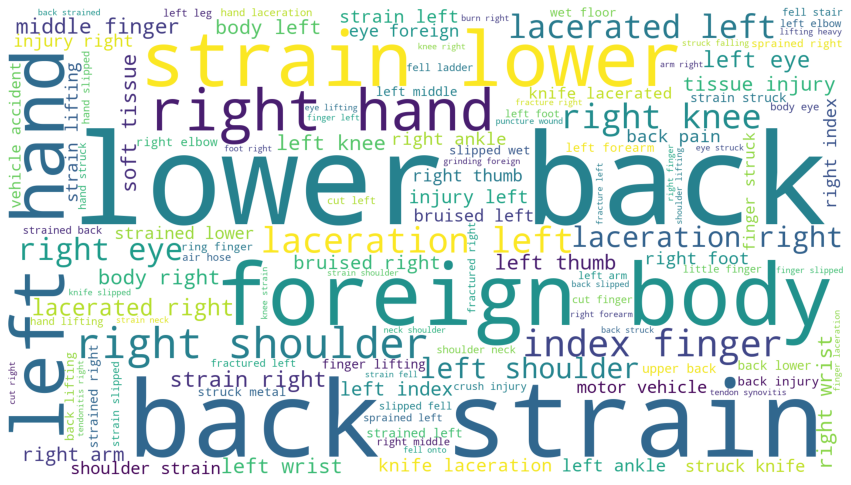

In [119]:
wordcloud = WordCloud(
    background_color="white",
    max_words=120,
    width=1920,
    height=1080).generate(' '.join(corpus.claim_description))
# Open a plot of the generated image.
plt.figure(figsize=(15,10))
plt.imshow(wordcloud)
plt.axis("off")
# plt.savefig('img/wordcloud.png')
plt.show()

### Out-of-bag words

Part of our data is unlabbeled (i.e. missing the target feature). We did not use this part of the data to create the custom vocabulary. Consequently, there may be descriptions that are out-of-the-bag as they not appear in the dictionary.

In [120]:
idx = corpus[corpus.encoded_tokens_with_padding.apply(lambda x: vocabulary.get('<UNK>') in x)].index
print('Number of observations where there is at least one oob-token:', len(idx))
corpus.loc[idx, 'out-of-bag-words'] = corpus.loc[idx].apply(lambda x: ', '.join([k for k in x['tokens'] if not vocabulary.get(k)]), axis=1)

Number of observations where there is at least one oob-token: 715


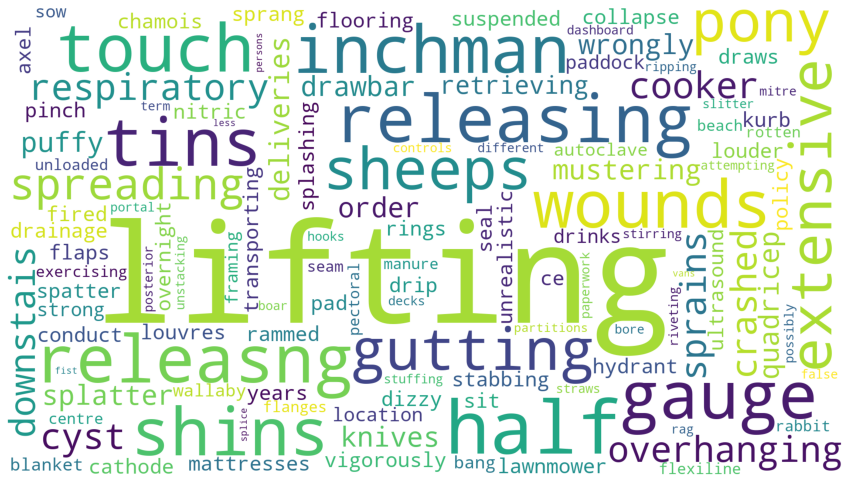

In [121]:
wordcloud = WordCloud(
    background_color="white",
    max_words=120,
    width=1920,
    height=1080).generate(corpus[corpus['out-of-bag-words'].notna()]['out-of-bag-words'].str.cat(sep=' '))
# Open a plot of the generated image.
plt.figure(figsize=(15,10))
plt.imshow(wordcloud)
plt.axis("off")
# plt.savefig('img/wordcloud.png')
plt.show()

### n-grams

In [122]:
def n_gram(sequence: list, n: int = 1):
    freq_dist = nltk.FreqDist(nltk.ngrams(sequence=sequence, n=n))
    df = pd.DataFrame(freq_dist.most_common(), columns=('word', 'freq'))
    df.word = df.word.apply(lambda n_gram: ' '.join(n_gram))
    return df

In [123]:
sequence = nltk.tokenize.word_tokenize(corpus.claim_description.str.cat(sep=' '))

In [124]:
df = n_gram(sequence, n=2).iloc[:10]
df['average-claim'] = [
    data.loc[
        data.claimdescription.str.lower().str.contains(ng),
        'ultimateincurredclaimcost'
    ].mean()
    for ng in df.word.to_list()
]
df

,word,freq,average-claim
0,lower back,15653,17903.539624
1,back strain,10459,17487.684596
2,foreign body,6521,1176.985252
3,strain lower,4988,17956.462694
4,left hand,4578,5401.078118
5,right hand,4377,5754.282004
6,right shoulder,4375,20177.466444
7,index finger,4321,3549.338177
8,laceration left,3815,3357.264891
9,right knee,3660,13675.875441


In [125]:
# check top n most frequent n-grams
n = 10
fig = px.bar(df.nlargest(n, columns='freq'), y='word', x='freq', title=f'{n} most frequent n-grams')
fig.show()

In [126]:
corpus.loc['WC8920309', 'claim_description']

'fell slipped on wet floor sprain left ankle sever infection'

## 3.7.&nbsp;Target feature: Claims

### Distribution

In insurance portfolios claims distributions usually left skewed with often heavy tails and there are outliers quite often.

In [127]:
data[['initialincurredclaimcost', 'ultimateincurredclaimcost']].skew(numeric_only=True).sort_values(ascending=False)

initialincurredclaimcost     22.142965
ultimateincurredclaimcost     8.518347
dtype: float64

In [128]:
fig = px.scatter(
    data,
    x='initialincurredclaimcost',
    y='ultimateincurredclaimcost',
    title='Scatter-plot of the initial and ultimate claims')
fig.show()

There is one data point which appers to be outlier. It has an out of range initial claim, but and average ultimate claim.

In [129]:
potential_outlier = data[data.initialincurredclaimcost == 2000000].index
data.loc[potential_outlier].iloc[:, :-14].T

ClaimNumber,WC9269123
claim_number,9269123
age,28
gender,M
maritalstatus,M
dependentchildren,0
dependentsother,0
weeklywages,590.0
parttimefulltime,F
hoursworkedperweek,42.0
daysworkedperweek,5


Based on the description of the claim and other features I decide to treat this as an erroneous observations and choose to correct it accordingly.

In [130]:
data.loc[potential_outlier, 'ultimateincurredclaimcost']  / (data.loc[potential_outlier, 'initialincurredclaimcost'] / 100 )

ClaimNumber
WC9269123    4.363165
dtype: float64

In [131]:
data.loc[potential_outlier, 'initialincurredclaimcost'] = data.loc[potential_outlier, 'initialincurredclaimcost'] / 100

In [132]:
fig = px.scatter(
    data,
    x='initialincurredclaimcost',
    y='ultimateincurredclaimcost',
    title='Scatter-plot of the initial and ultimate claims')
fig.show()

In [133]:
df = data[['initialincurredclaimcost', 'ultimateincurredclaimcost']].copy()
df.columns = ['initial', 'ultimate']
df = df.melt(var_name='type', value_name='claim')

fig = px.histogram(df, x='claim', color='type',
                   title='Histogram of the initial and ultimate claims')
fig.show()

We can reinforce that the distribution of claims is left skewed with heavy tail and there are many outliers. There may be a log-linear connection between the initial and ultimate claims.

### Claim inflation

Previously we observed that the data spans several decades, so we need to investigate the inflation of the claims.

In [134]:
col = ['accident_year']
df = data.groupby(col).agg({'initialincurredclaimcost': 'median',
                            'ultimateincurredclaimcost': 'median'})
df.columns = ['initial', 'ultimate']
df = df.assign(ultimate_p_initial = df['ultimate'] / df['initial']) - 1

fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=df.index, y=df.initial, name="initial"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=df.index, y=df.ultimate, name="ultimate"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=df.index, y=df.ultimate_p_initial, name="ultimate_p_initial"),
    secondary_y=True,
)

# Add figure title
fig.update_layout(
    title_text=f"Median of incurred claims by {col}"
)

# Set x-axis title
fig.update_xaxes(title_text="Accident year")

# Set y-axes titles
fig.update_yaxes(title_text="median value of incurred claims", secondary_y=False)
fig.update_yaxes(title_text="ultimate / incurred claims - 1", secondary_y=True)
fig.update_xaxes(
    dtick=1
)
fig.show()

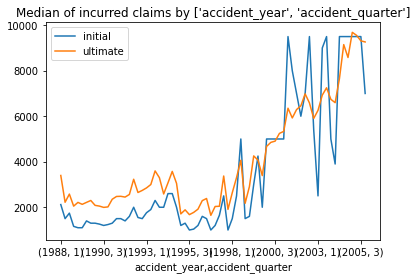

In [135]:
col = ['accident_year', 'accident_quarter']
df = data.groupby(col).agg({'initialincurredclaimcost': 'median',
                            'ultimateincurredclaimcost': 'median'})
df.columns = ['initial', 'ultimate']
df.plot(kind='line', title=f'Median of incurred claims by {col}')
plt.show()

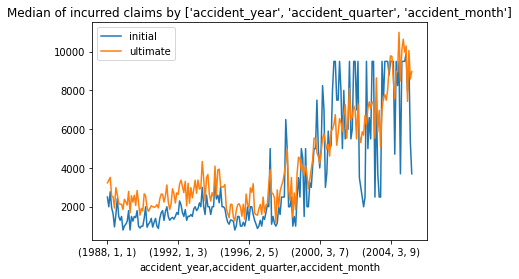

In [136]:
col = ['accident_year', 'accident_quarter', 'accident_month']
df = data.groupby(col).agg({'initialincurredclaimcost': 'median',
                            'ultimateincurredclaimcost': 'median'})
df.columns = ['initial', 'ultimate']
df.plot(kind='line', title=f'Median of incurred claims by {col}')
plt.show()

In [137]:
# calculating cumulative inflation of median claims per accident year
col = ['accident_year']
df = data.query('source == "data"').groupby(col).agg(
    {'initialincurredclaimcost': 'median',
     'ultimateincurredclaimcost': 'median'}
     )
df = df.div(df.shift(1).fillna(df)).cumprod()

# calculating the cumulative annual growth in the external indicators 
df_ext = external_data.query(f'country_name == "Australia" and year >= {df.index.min()} and year <= {df.index.max()}')[['year', 'value', 'indicator_name']].pivot_table(columns='indicator_name', values='value', index='year')
df_ext = df_ext.div(df_ext.shift(1).fillna(df_ext)).cumprod()

# we merge the two tables together
df = pd.merge(df, df_ext, how='left', left_index=True, right_index=True)

In [138]:
df

,initialincurredclaimcost,ultimateincurredclaimcost,GDP (constant 2015 US$),"Inflation, consumer prices (annual %)","Official exchange rate (LCU per US$, period average)"
accident_year,,,,,
1988,1.000,1.000000,1.000000,1.000000,1.000000
1989,0.650,0.861490,1.038644,1.044064,0.988037
1990,0.625,0.795618,1.075760,1.016226,1.000897
1991,0.700,0.945388,1.071510,0.440230,1.003006
1992,0.825,1.085579,1.075944,0.140277,1.063864
1993,1.000,1.234913,1.119343,0.243025,1.148957
1994,1.000,1.167116,1.163898,0.272956,1.068632
1995,0.600,0.684290,1.208520,0.641326,1.054007
1996,0.660,0.777622,1.255101,0.362445,0.998402


In [139]:
fig = px.line(df, title='Comparing claim inflation with external metrics')
fig.update_xaxes(
    dtick=1
)
fig.update_layout(
    legend=dict(
        x=0,
        y=-1,
        traceorder="normal",
    )
)
fig.show()

We observe that there is an odd pattern in the inflation of claims:
- after the first observation year the median decreased and it takes 5 years for the median claims to reach the level of the first year
- in 1994 there is a 10% growth in initial claims but then again a descrease for a few years
- after the millenium there is a huge increase in the claims inflation, higher in the initial than in the ultimate claims
- the external indicators do not show any pattern that would give us hints on the nature of claim inflation.

Unfortunately, we do not have enough information to work on this further. We would need the information that what happens between when a claim is initially recognised and when it is ultimately settled. There may be factors in the insurers practice that change (for example they apply a more prudent approach for some reason when recognising the initial incurred claims in some years compared to other years - this could explain the high peaks in the initial claims).

In [140]:
# I merge the cumulative inflation metric to the original dataset
data['c_inflation'] = pd.merge(
    left=data[['accident_year', 'ultimateincurredclaimcost']],
    right=df['ultimateincurredclaimcost'].reset_index().rename(columns={'ultimateincurredclaimcost': 'c_inflation'}),
    on='accident_year',
    how='left'
)['c_inflation'].values
# use this metric to remove the inflation effect from the ultimate incurred claim cost and store it in a new variable
data['inf_ultimateincurredclaimcost'] = data.eval('ultimateincurredclaimcost / c_inflation')

In [141]:
col = ['accident_year']
df = data.groupby(col).agg({'inf_ultimateincurredclaimcost': 'mean'})
df.columns = ['ultimate']

fig = px.line(df, title=f"Average of incurred claims by {col} after removing the effect of median claims inflation")
fig.update_xaxes(
    dtick=1
)
fig.show()

### Log-transformation

A log-transformation is commonly used in case of left-skewed data (`np.log1p` actually calculates $\log(1+x)$ which we need to keep in mind in case we will predict the log-transformed target).

In [142]:
# calculate transformed variables
cols = ['initialincurredclaimcost', 'ultimateincurredclaimcost', 'inf_ultimateincurredclaimcost']
for col in cols:
    data[f'log_{col}'] = np.log1p(data[col])

In [143]:
fig = px.scatter(data,
                 x='log_initialincurredclaimcost',
                 y='log_ultimateincurredclaimcost',
                 title='Scatter-plot of the log-transformed initial and ultimate claims')
fig.show()

In [144]:
df = data[['log_initialincurredclaimcost', 'log_ultimateincurredclaimcost']].copy()
df.columns = ['initial', 'ultimate']
df = df.melt(var_name='type', value_name='claim')

fig = px.histogram(df, x='claim', color='type',
                   title='Histogram of the initial and ultimate claims')
fig.show()

In [145]:
data.columns

Index(['claim_number', 'age', 'gender', 'maritalstatus', 'dependentchildren',
       'dependentsother', 'weeklywages', 'parttimefulltime',
       'hoursworkedperweek', 'daysworkedperweek', 'claimdescription',
       'initialincurredclaimcost', 'source', 'ultimateincurredclaimcost',
       'reporting_date', 'accident_date', 'accident_hour', 'reporting_year',
       'reporting_month', 'reporting_quarter', 'reporting_day',
       'accident_year', 'accident_month', 'accident_quarter', 'accident_day',
       'delay_month', 'delay_day', 'delay_quarter', 'delay_year', 'delay_week',
       'c_inflation', 'inf_ultimateincurredclaimcost',
       'log_initialincurredclaimcost', 'log_ultimateincurredclaimcost',
       'log_inf_ultimateincurredclaimcost'],
      dtype='object')

In [146]:
# # taking into account the inflation of claims
# # calculate transformed variables
# cols = ['inf_initialincurredclaimcost', 'inf_ultimateincurredclaimcost']
# for col in cols:
#     data[f'log_{col}'] = np.log1p(data[col])

# fig = px.scatter(data,
#                  x='log_initialincurredclaimcost',
#                  y='log_inf_ultimateincurredclaimcost',
#                  title='Scatter-plot of the initial and log-ultimate claims')
# fig.show()

# df = data[['log_inf_initialincurredclaimcost', 'log_inf_ultimateincurredclaimcost']].copy()
# df.columns = ['initial', 'ultimate']
# df = df.melt(var_name='type', value_name='claim')

# fig = px.histogram(df, x='claim', color='type',
#                    title='Histogram of the initial and ultimate claims')
# fig.show()

### Outlier detection using isolation-forests

In [147]:
df = data.query('source == "data"').select_dtypes(exclude=['object', 'datetime']).copy()
for col in df.select_dtypes('category').columns:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])

In [148]:
# fitting
clf = IsolationForest(random_state=42, contamination='auto')
clf.fit(df)
y_isoforest = clf.predict(df)

# evaluating
col = 'isoforest'
y_isoforest = pd.DataFrame({col: (y_isoforest == -1).astype(int)}, index=df.index)
y_isoforest.value_counts(normalize=True)

isoforest
0            0.878759
1            0.121241
dtype: float64

In [149]:
# add isolation forest based on indices to original dataframe
try:
    data.drop('isoforest', axis=1, inplace=True)
except:
    pass
data = pd.concat([data, y_isoforest], axis=1)

In [150]:
fig = px.scatter(data,
                 x='log_initialincurredclaimcost',
                 y='log_ultimateincurredclaimcost',
                 color='isoforest',
                 title='Scatter-plot of the initial and ultimate claims (highligting outliers detected by isolation forest)')
fig.show()

In [151]:
fig = px.scatter(data.query('isoforest == 1'),
                 x='log_initialincurredclaimcost',
                 y='log_ultimateincurredclaimcost',
                 color='isoforest',
                 title='Scatter-plot of the initial and ultimate claims (showing only outliers detected by isolation forest)')
fig.show()

# 4.&nbsp;NLP (LSTM classifiation)

## Labels

In [314]:
target_col_name = 'log_inf_ultimateincurredclaimcost'
# quartile labels  - creating quartile label per accident year
nlp_data = pd.merge(
    left=corpus,
    right=data[['accident_year', 'ultimateincurredclaimcost', 'c_inflation', 'log_inf_ultimateincurredclaimcost', 'isoforest']],
    how='left',
    left_index=True, right_index=True
)

nlp_data.rename(
    columns={target_col_name: 'ultimate_claim'},
    inplace=True
)

# exclude kaggle set
nlp_data = nlp_data.query('source == "data"').copy()

# calculate quartile labels per accident year
for year in set(nlp_data.accident_year):
    nlp_data.loc[nlp_data.accident_year == year, 'labels'] = pd.qcut(
        x=nlp_data.loc[nlp_data.accident_year == year, 'ultimate_claim'],
        q=4,
        labels=[0, 1, 2, 3]  # we need to start the labelling from zero for pytorch
    )

# set the datatype of the labels
nlp_data.labels = nlp_data.labels.astype(int)

# glimpse on the data 
nlp_data.head()

,source,ClaimDescription,claim_description,char_len,word_count,word_count_unique,tokens,token_count,token_count_unique,encoded_tokens,padding,encoded_tokens_with_padding,out-of-bag-words,accident_year,ultimateincurredclaimcost,c_inflation,ultimate_claim,isoforest,labels
ClaimNumber,,,,,,,,,,,,,,,,,,,
WC8285054,data,LIFTING TYRE INJURY TO RIGHT ARM AND WRIST INJURY,lifting tyre injury to right arm and wrist injury,49,9,8,"[lifting, tyre, injury, to, right, arm, and, w...",9,8,"[3729, 0, 1, 2, 3, 4, 5, 6, 7, 2, 3730]","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 0, 1, 2, ...",NaN,2002,4748.203388,2.541578,7.533271,0.0,1
WC6982224,data,STEPPED AROUND CRATES AND TRUCK TRAY FRACTURE ...,stepped around crates and truck tray fracture ...,58,9,9,"[stepped, around, crates, and, truck, tray, fr...",9,9,"[3729, 8, 9, 10, 6, 11, 12, 13, 14, 15, 3730]","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 8, 9, 10,...",NaN,1999,6326.285819,1.418077,8.403391,0.0,2
WC5481426,data,CUT ON SHARP EDGE CUT LEFT THUMB,cut on sharp edge cut left thumb,32,7,6,"[cut, on, sharp, edge, cut, left, thumb]",7,6,"[3729, 16, 17, 18, 19, 16, 14, 20, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 372...",NaN,1996,2293.949087,0.777622,7.989884,0.0,2
WC9775968,data,DIGGING LOWER BACK LOWER BACK STRAIN,digging lower back lower back strain,36,6,4,"[digging, lower, back, lower, back, strain]",6,4,"[3729, 21, 22, 23, 22, 23, 24, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 372...",NaN,2005,17786.487170,3.661953,8.488404,0.0,2
WC2634037,data,REACHING ABOVE SHOULDER LEVEL ACUTE MUSCLE STR...,reaching above shoulder level acute muscle str...,70,11,11,"[reaching, above, shoulder, level, acute, musc...",11,11,"[3729, 25, 26, 27, 28, 29, 30, 24, 14, 31, 32,...","[3728, 3728, 3728]","[3728, 3728, 3728, 3729, 25, 26, 27, 28, 29, 3...",NaN,1990,4014.002925,0.795618,8.526378,0.0,2


## Extract input and output tensors

In [155]:
train_proportion = 0.8  # 80% train, 20% dev
test_proportion = 0.1  # 10% of the dev is test

X = torch.from_numpy(np.array(nlp_data.encoded_tokens_with_padding.to_list())).to(device)
y = torch.LongTensor(nlp_data.labels.values).to(device)
seqlen = torch.LongTensor(nlp_data.encoded_tokens_with_padding.apply(len).values)

# train indices
idx_train = np.random.choice(
    range(X.shape[0]),
    size=int(X.shape[0] * train_proportion),
    replace=False,
    p=None)

# dev indices
idx_dev = np.arange(X.shape[0])[~np.isin(np.arange(X.shape[0]), idx_train)]

# selecting test indices
idx_test = np.random.choice(
    idx_dev,
    size=int(idx_dev.shape[0] * test_proportion),
    replace=False, p=None
)

# excluding test indicies from dev indices
idx_dev = idx_dev[~np.isin(idx_dev, idx_test)]

# checks to see whether that the intersection of sets is empty
assert not set(idx_dev).intersection(set(idx_test))
assert not set(idx_train).intersection(set(idx_dev).union(set(idx_test)))

X_train, y_train, seqlen_train = X[idx_train, :], y[idx_train], seqlen[idx_train]
X_dev, y_dev, seqlen_dev = X[idx_dev, :], y[idx_dev], seqlen[idx_dev]
X_test, y_test, seqlen_test = X[idx_test, :], y[idx_test], seqlen[idx_test]

print(X.type(), y.type(), seqlen.type())
print(X.shape, y.shape, seqlen.shape)
print(int(X.shape[0] * train_proportion))
print(
    'total:', len(set(idx_train).union(set(idx_dev).union(set(idx_test)))),
    'train:', len(idx_train),
    'dev:', len(idx_dev),
    'test:', len(idx_test)
)

print(seqlen[idx_train])
print(X_train.shape, y_train.shape, seqlen_train.shape)
print(X_dev.shape, y_dev.shape, seqlen_dev.shape)
print(X_test.shape, y_test.shape, seqlen_test.shape)

torch.cuda.LongTensor torch.cuda.LongTensor torch.LongTensor
torch.Size([54000, 16]) torch.Size([54000]) torch.Size([54000])
43200
total: 54000 train: 43200 dev: 9720 test: 1080
tensor([16, 16, 16,  ..., 16, 16, 16])
torch.Size([43200, 16]) torch.Size([43200]) torch.Size([43200])
torch.Size([9720, 16]) torch.Size([9720]) torch.Size([9720])
torch.Size([1080, 16]) torch.Size([1080]) torch.Size([1080])


## LSTM with PackedPaddedSequence

In [156]:
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, embedding_size, hidden_size, output_size):
        super().__init__()

        # # Embedding
        # https://pytorch.org/docs/stable/generated/torch.nn.Embedding.html
        self.embedding = nn.Embedding(
            num_embeddings=input_size,  # size of the dictionary of embeddings
            embedding_dim=embedding_size  # the size of each embedding vector
        )

        # # LSTM
        # https://pytorch.org/docs/stable/generated/torch.nn.LSTM.html#torch.nn.LSTM
        self.lstm = nn.LSTM(
            input_size=embedding_size,  # The number of expected features in the input x
            hidden_size=hidden_size,  # The number of features in the hidden state h
            num_layers=1,  # Number of recurrent layers. Default: 1
            bias=True,  # If False, then the layer does not use bias weights. Default: True
            batch_first=True,  # If True, then the input and output tensors are provided as (batch, seq, feature) instead of (seq, batch, feature). Default: False
            dropout=0,  # If non-zero, introduces a Dropout layer on the outputs of each LSTM layer except the last layer, with dropout probability equal to dropout. Default: 0
            bidirectional=True  # If True, becomes a bidirectional LSTM. Default: False
        )

        # # Linear dense layer
        # https://pytorch.org/docs/stable/generated/torch.nn.Linear.html
        self.dense = nn.Linear(
            in_features=hidden_size * 2,
            out_features=output_size
        ) 

    def forward(self, sequences: torch.Tensor, sequence_lens: torch.Tensor) -> torch.Tensor:
        embedded_seq_tensor = self.embedding(sequences)

        # # THIS IS THE MODIFIED PART
        # packed_input: is a PackedSequence object
        # https://pytorch.org/docs/stable/generated/torch.nn.utils.rnn.pack_padded_sequence.html
        packed_input = nn.utils.rnn.pack_padded_sequence(
            input=embedded_seq_tensor,  # padded batch of variable length sequences
            lengths=sequence_lens,  # list of sequence lengths of each batch element (must be on the CPU if provided as a tensor)
            batch_first=True,  # if True, the input is expected in B x T x * format.
            enforce_sorted=False  # If False, the input will get sorted unconditionally.
        )

        # # Outputs of the LSTM
        # h: tensor containing the final hidden state for each element in the sequence
        # c: tensor  containing the final cell state for each element in the sequence
        packed_outputs, (h, c) = self.lstm(packed_input)
        h = torch.cat((h[0], h[1]), dim=-1)
        output = self.dense(h)  # BN
        return output

## Instantiating the model

In [174]:
# the input and the output size are determined by the alphabet and the number of labels
input_size = len(vocabulary)
output_size = nlp_data.labels.nunique()
# the rest are up to us
embedding_size = 30  # 30
hidden_size = 64  # 64
# instantiate the model
model = LSTMClassifier(input_size, embedding_size, hidden_size, output_size)
# send to device
model.to(device)
# print model summary
print(input_size, output_size, embedding_size, hidden_size)
model

3732 4 30 64


LSTMClassifier(
  (embedding): Embedding(3732, 30)
  (lstm): LSTM(30, 64, batch_first=True, bidirectional=True)
  (dense): Linear(in_features=128, out_features=4, bias=True)
)

## Batching

In [175]:
class BatchedIterator:
    def __init__(self, *tensors, batch_size):
        # all tensors must have the same first dimension
        assert len(set(len(tensor) for tensor in tensors)) == 1
        self.tensors = tensors
        self.batch_size = batch_size
    
    def iterate_once(self):
        num_data = len(self.tensors[0])
        for start in range(0, num_data, self.batch_size):
            end = start + self.batch_size
            yield tuple(tensor[start:end] for tensor in self.tensors)

## Loss function and optimizer

In [176]:
# initialize criterion
criterion = nn.CrossEntropyLoss()
# send to device
criterion.to(device)
# initialize optimizer
optimizer = optim.Adam(model.parameters())

## Sanity check

Train and dev accuracy should be really bad without training.

In [177]:
logits = model(X_train, seqlen_train)
y = logits.argmax(axis=1)
accuracy = torch.sum(torch.eq(y, y_train)) / y.size(0)
print(f"Train accuracy: {accuracy:.1%}")

Train accuracy: 25.0%


In [178]:
logits = model(X_dev, seqlen_dev)
y = logits.argmax(axis=1)
accuracy = torch.sum(torch.eq(y, y_dev)) / y.size(0)
print(f"Dev accuracy: {accuracy:.1%}")

Dev accuracy: 25.0%


We have four bins, so current accuracy is similar to random chance which is expected.

## Training

We collect training statistics at the end of each epochs in the variable `metrics`.

We train the model batch by batch and then evaluate it on the train and the dev data at the end of each epoch. Since the dataset is small, we can evaluate it the whole data in one step without batching.

Note that the model should be set to train or eval mode accordingly. Stochastic steps such as dropout are disabled in eval mode.

In [179]:
num_epochs = 30
batch_size = 128

metrics = defaultdict(list)
train_iter = BatchedIterator(X_train, seqlen_train, y_train, batch_size=batch_size)

In [183]:
for epoch in range(num_epochs):
    model.train()
    # Training loop
    for X_batch, seqlen_batch, y_batch in train_iter.iterate_once():
        optimizer.zero_grad()  # clear gradients
        y_out = model(X_batch, seqlen_batch)
        loss = criterion(y_out, y_batch)  # evaluate the loss
        loss.backward()  # back-propagation
        optimizer.step()  # update with new gradients
        
    with torch.no_grad():
        # # Context-manager that disabled gradient calculation.
        # https://pytorch.org/docs/stable/generated/torch.no_grad.html
        # the evaluation path is currently not processed in batches, because the data is small
        model.eval()

        # Train and dev loss at the end of the epoch
        y_out = model(X_train, seqlen_train)
        train_loss = criterion(y_out, y_train).item()
        metrics['train_loss'].append(train_loss)
        labels = y_out.argmax(axis=1)
        train_accuracy = (torch.eq(y_train, labels).sum() / labels.size(0)).item()
        metrics['train_accuracy'].append(train_accuracy)

        y_out = model(X_dev, seqlen_dev)
        dev_loss = criterion(y_out, y_dev).item()
        metrics['dev_loss'].append(dev_loss)
        labels = y_out.argmax(axis=1)
        dev_accuracy = (torch.eq(y_dev, labels).sum() / labels.size(0)).item()
        
        # store best model
        if len(metrics['dev_accuracy']) == 0:
            best_model_state_clf = deepcopy(model.state_dict())
        elif dev_accuracy > max(metrics['dev_accuracy']):
            # print(f'epoch={epoch}')
            best_model_state_clf = deepcopy(model.state_dict())

        metrics['dev_accuracy'].append(dev_accuracy)


    
    print(f"epoch={epoch+1} -- train_loss={train_loss:.3f} - train_accuracy={train_accuracy:.1%} - test_loss={dev_loss:.3f} - test_accuracy={dev_accuracy:.1%}")

epoch=1 -- train_loss=1.042 - train_accuracy=50.8% - test_loss=1.054 - test_accuracy=49.3%
epoch=2 -- train_loss=1.031 - train_accuracy=51.5% - test_loss=1.048 - test_accuracy=50.0%
epoch=3 -- train_loss=1.023 - train_accuracy=52.1% - test_loss=1.045 - test_accuracy=50.4%
epoch=4 -- train_loss=1.017 - train_accuracy=52.5% - test_loss=1.044 - test_accuracy=50.6%
epoch=5 -- train_loss=1.011 - train_accuracy=52.9% - test_loss=1.045 - test_accuracy=50.6%
epoch=6 -- train_loss=1.005 - train_accuracy=53.2% - test_loss=1.046 - test_accuracy=50.5%
epoch=7 -- train_loss=0.999 - train_accuracy=53.7% - test_loss=1.049 - test_accuracy=50.4%
epoch=8 -- train_loss=0.992 - train_accuracy=54.1% - test_loss=1.052 - test_accuracy=50.3%
epoch=9 -- train_loss=0.984 - train_accuracy=54.7% - test_loss=1.058 - test_accuracy=50.2%
epoch=10 -- train_loss=0.975 - train_accuracy=55.3% - test_loss=1.065 - test_accuracy=49.9%
epoch=11 -- train_loss=0.965 - train_accuracy=55.9% - test_loss=1.075 - test_accuracy=49.

## Evaluation

### Training curves

In [186]:
title = 'Evaluation of the LSTM classification model'
fig = make_subplots(rows=2, cols=2)
fig.add_trace(
    go.Scatter(x=list(range(num_epochs)), y=metrics['train_loss'], name='train_loss'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=list(range(num_epochs)), y=metrics['dev_loss'], name='dev_loss'),
    row=1, col=2
)

fig.add_trace(
    go.Scatter(x=list(range(num_epochs)), y=metrics['train_accuracy'], name='train_accuracy'),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=list(range(num_epochs)), y=metrics['dev_accuracy'], name='dev_accuracy'),
    row=2, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=True)
# fig.update_xaxes(
#     title='epochs',
#     dtick=1
# )
fig.show()

### Test accuracy

In [ ]:
# model.load_state_dict(torch.load(PATH)) 
model.load_state_dict(best_model_state_clf)

In [187]:
logits = model(X_test, seqlen_test)
test_prediction = logits.argmax(axis=1)
test_accuracy = torch.sum(torch.eq(test_prediction, y_test)) / y_test.size(0)
print(f"Test accuracy: {test_accuracy:.1%}")

Test accuracy: 53.4%


### Incorrectly classified examples

In [188]:
test_prediction = test_prediction.cpu().numpy()
y_test = y_test.cpu().numpy()

In [189]:
# check wheter the slicing is correct
(y_test == nlp_data.iloc[idx_test].labels.values).all()

True

In [201]:
result = pd.concat([nlp_data.iloc[idx_test, :].reset_index(), pd.DataFrame({'predictions': test_prediction})], axis=1).set_index('ClaimNumber')
result['diff'] = result.eval('labels - predictions')

In [202]:
result_cols = ['claim_description', 'accident_year', 'ultimateincurredclaimcost', 'c_inflation', 'labels', 'predictions', 'diff']
result.query('labels != predictions')[result_cols].head()

,claim_description,accident_year,ultimateincurredclaimcost,c_inflation,labels,predictions,diff
ClaimNumber,,,,,,,
WC8372594,sprayed in eye irritation to right chest,2002,19634.738010,2.541578,3,0,3
WC2291227,strain on back back strain,1989,5364.640782,0.861490,2,3,-1
WC2559044,motor vehicle collision soft tissue injury lef...,1990,6800.175030,0.795618,3,2,1
WC4390843,struck against glass panel lacerated left forearm,1993,3626.969499,1.234913,2,0,2
WC3869694,lifting resident back strain lower back,1992,4736.695162,1.085579,2,3,-1


In [205]:
# looking at the largest differences (largest possible difference is either +3 or -3)
result.query('diff == 3')[result_cols].head()

,claim_description,accident_year,ultimateincurredclaimcost,c_inflation,labels,predictions,diff
ClaimNumber,,,,,,,
WC8372594,sprayed in eye irritation to right chest,2002,19634.738010,2.541578,3,0,3
WC8919048,fall from ladder right hand burn right eye,2003,28962.420360,2.620399,3,0,3
WC5596762,struck against sheet metal laceration left rin...,1996,28441.618440,0.777622,3,0,3
WC5603058,angle grinder slipped cut right index finger,1996,14088.134510,0.777622,3,0,3
WC5970160,dismantle dental syringe puncture needle stick...,1997,7872.841405,0.882657,3,0,3


In [203]:
# highest claim
result.loc[result.query('diff == 3')['ultimateincurredclaimcost'].idxmax(), result_cols]

claim_description            using angle grinder laceration left hand
accident_year                                                    2005
ultimateincurredclaimcost                                 36770.73335
c_inflation                                                  3.661953
labels                                                              3
predictions                                                         0
diff                                                                3
Name: WC9788282, dtype: object

In [241]:
search_phrase = 'laceration'
condition = nlp_data.claim_description.str.contains(search_phrase)
print(f'{sum(condition)} of the total {len(nlp_data)} observations contain the search phrase "{search_phrase}" ({sum(condition) / len(nlp_data):.1%})')
print(pd.DataFrame({'count': nlp_data.loc[condition, 'labels'].value_counts(),
                    'proportion': (nlp_data.loc[condition, 'labels'].value_counts(normalize=True) * 100).astype(str).str[:4] + '%'}))
print(f'The average label is {nlp_data.loc[condition, "labels"].mean()}')

5156 of the total 54000 observations contain the search phrase "laceration" (9.5%)
   count proportion
0   2739      53.1%
1   1466      28.4%
2    563      10.9%
3    388      7.52%
The average label is 0.7284716834755625


In [242]:
search_phrase = 'angle grinder'
condition = nlp_data.claim_description.str.contains(search_phrase)
print(f'{sum(condition)} of the total {len(nlp_data)} observations contain the search phrase "{search_phrase}" ({sum(condition) / len(nlp_data):.1%})')
print(pd.DataFrame({'count': nlp_data.loc[condition, 'labels'].value_counts(),
                    'proportion': (nlp_data.loc[condition, 'labels'].value_counts(normalize=True) * 100).astype(str).str[:4] + '%'}))
print(f'The average label is {nlp_data.loc[condition, "labels"].mean()}')

68 of the total 54000 observations contain the search phrase "angle grinder" (0.1%)
   count proportion
0     26      38.2%
1     23      33.8%
3     10      14.7%
2      9      13.2%
The average label is 1.0441176470588236


In [232]:
# looking at the largest differences (largest possible difference is either +3 or -3)
result.query('diff == -3')[result_cols]

,claim_description,accident_year,ultimateincurredclaimcost,c_inflation,labels,predictions,diff
ClaimNumber,,,,,,,
WC9716035,normal duties lower back strain,2005,2359.64611,3.661953,0,3,-3


In [233]:
result.loc[result.query('diff == -3')['ultimateincurredclaimcost'].idxmin(), result_cols]

claim_description            normal duties lower back strain
accident_year                                           2005
ultimateincurredclaimcost                         2359.64611
c_inflation                                         3.661953
labels                                                     0
predictions                                                3
diff                                                      -3
Name: WC9716035, dtype: object

In [239]:
search_phrase = 'lower back strain'
condition = nlp_data.claim_description.str.contains(search_phrase)
print(f'{sum(condition)} of the total {len(nlp_data)} observations contain the search phrase "{search_phrase}" ({sum(condition) / len(nlp_data):.1%})')
print(pd.DataFrame({'count': nlp_data.loc[condition, 'labels'].value_counts(),
                    'proportion': (nlp_data.loc[condition, 'labels'].value_counts(normalize=True) * 100).astype(str).str[:4] + '%'}))
print(f'The average label is {nlp_data.loc[condition, "labels"].mean()}')

4631 of the total 54000 observations contain the search phrase "lower back strain" (8.6%)
   count proportion
2   2152      46.4%
3   2128      45.9%
1    346      7.47%
0      5      0.10%
The average label is 2.382638738933276


In [240]:
search_phrase = 'normal duties'
condition = nlp_data.claim_description.str.contains(search_phrase)
print(f'{sum(condition)} of the total {len(nlp_data)} observations contain the search phrase "{search_phrase}" ({sum(condition) / len(nlp_data):.1%})')
print(pd.DataFrame({'count': nlp_data.loc[condition, 'labels'].value_counts(),
                    'proportion': (nlp_data.loc[condition, 'labels'].value_counts(normalize=True) * 100).astype(str).str[:4] + '%'}))
print(f'The average label is {nlp_data.loc[condition, "labels"].mean()}')

38 of the total 54000 observations contain the search phrase "normal duties" (0.1%)
   count proportion
0     14      36.8%
1     12      31.5%
2      6      15.7%
3      6      15.7%
The average label is 1.105263157894737


## Confusion matrix

In [243]:
cm = confusion_matrix(y_test, test_prediction)
cm

array([[231,  40,   0,   1],
       [ 72, 147,  31,  21],
       [ 30,  79,  76,  84],
       [ 18,  60,  67, 123]])

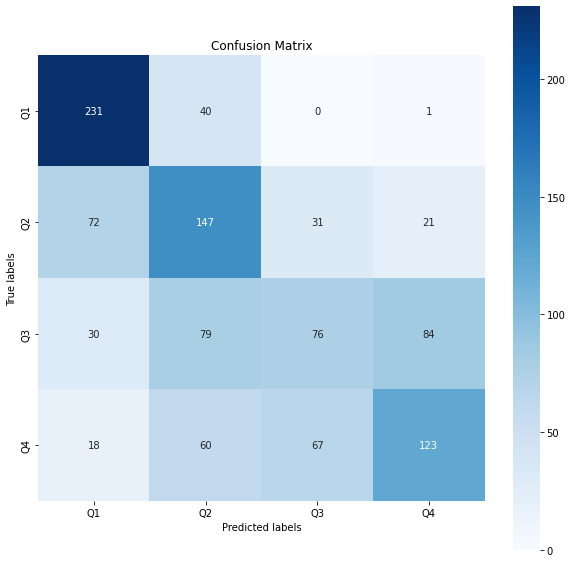

In [244]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sns.heatmap(
    cm,
    annot=True,
    square=True,
    cmap='Blues',
    fmt='d',
    xticklabels=['Q1', 'Q2', 'Q3', 'Q4'],
    yticklabels=['Q1', 'Q2', 'Q3', 'Q4'],
    ax=ax)

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
plt.show()

In [245]:
print('\nClassification Report\n')
print(classification_report(
    y_test,
    test_prediction,
    target_names=['Q1', 'Q2', 'Q3', 'Q4']))


Classification Report

              precision    recall  f1-score   support

          Q1       0.66      0.85      0.74       272
          Q2       0.45      0.54      0.49       271
          Q3       0.44      0.28      0.34       269
          Q4       0.54      0.46      0.49       268

    accuracy                           0.53      1080
   macro avg       0.52      0.53      0.52      1080
weighted avg       0.52      0.53      0.52      1080



# 5.&nbsp;NLP (LSTM regression)

## Target

In [246]:
# numerical labels
target_col_name = 'log_inf_ultimateincurredclaimcost'
nlp_data.head()

,source,ClaimDescription,claim_description,char_len,word_count,word_count_unique,tokens,token_count,token_count_unique,encoded_tokens,padding,encoded_tokens_with_padding,out-of-bag-words,accident_year,ultimateincurredclaimcost,c_inflation,ultimate_claim,isoforest,labels
ClaimNumber,,,,,,,,,,,,,,,,,,,
WC8285054,data,LIFTING TYRE INJURY TO RIGHT ARM AND WRIST INJURY,lifting tyre injury to right arm and wrist injury,49,9,8,"[lifting, tyre, injury, to, right, arm, and, w...",9,8,"[3729, 0, 1, 2, 3, 4, 5, 6, 7, 2, 3730]","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 0, 1, 2, ...",NaN,2002,4748.203388,2.541578,7.533271,0.0,1
WC6982224,data,STEPPED AROUND CRATES AND TRUCK TRAY FRACTURE ...,stepped around crates and truck tray fracture ...,58,9,9,"[stepped, around, crates, and, truck, tray, fr...",9,9,"[3729, 8, 9, 10, 6, 11, 12, 13, 14, 15, 3730]","[3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3729, 8, 9, 10,...",NaN,1999,6326.285819,1.418077,8.403391,0.0,2
WC5481426,data,CUT ON SHARP EDGE CUT LEFT THUMB,cut on sharp edge cut left thumb,32,7,6,"[cut, on, sharp, edge, cut, left, thumb]",7,6,"[3729, 16, 17, 18, 19, 16, 14, 20, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 372...",NaN,1996,2293.949087,0.777622,7.989884,0.0,2
WC9775968,data,DIGGING LOWER BACK LOWER BACK STRAIN,digging lower back lower back strain,36,6,4,"[digging, lower, back, lower, back, strain]",6,4,"[3729, 21, 22, 23, 22, 23, 24, 3730]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 3728]","[3728, 3728, 3728, 3728, 3728, 3728, 3728, 372...",NaN,2005,17786.487170,3.661953,8.488404,0.0,2
WC2634037,data,REACHING ABOVE SHOULDER LEVEL ACUTE MUSCLE STR...,reaching above shoulder level acute muscle str...,70,11,11,"[reaching, above, shoulder, level, acute, musc...",11,11,"[3729, 25, 26, 27, 28, 29, 30, 24, 14, 31, 32,...","[3728, 3728, 3728]","[3728, 3728, 3728, 3729, 25, 26, 27, 28, 29, 3...",NaN,1990,4014.002925,0.795618,8.526378,0.0,2


## Extract input and output tensors

In [247]:
train_proportion = 0.8  # 80% traint 20% dev
test_proportion = 0.1  # 10% of the dev is test

X = torch.from_numpy(np.array(nlp_data.encoded_tokens_with_padding.to_list())).to(device)
y = torch.FloatTensor(nlp_data.ultimate_claim.values).to(device)
seqlen = torch.LongTensor(nlp_data.encoded_tokens_with_padding.apply(len).values)


# train indices
idx_train = np.random.choice(
    range(X.shape[0]),
    size=int(X.shape[0] * train_proportion),
    replace=False,
    p=None)

# dev indices
idx_dev = np.arange(X.shape[0])[~np.isin(np.arange(X.shape[0]), idx_train)]

# selecting test indices
idx_test = np.random.choice(
    idx_dev,
    size=int(idx_dev.shape[0] * test_proportion),
    replace=False, p=None
)

# excluding test indicies from dev indices
idx_dev = idx_dev[~np.isin(idx_dev, idx_test)]

# checks to see whether that the intersection of sets is empty
assert not set(idx_dev).intersection(set(idx_test))
assert not set(idx_train).intersection(set(idx_dev).union(set(idx_test)))

X_train, y_train, seqlen_train = X[idx_train, :], y[idx_train], seqlen[idx_train]
X_dev, y_dev, seqlen_dev = X[idx_dev, :], y[idx_dev], seqlen[idx_dev]
X_test, y_test, seqlen_test = X[idx_test, :], y[idx_test], seqlen[idx_test]

print('X, y, seqlen type:', X.type(), y.type(), seqlen.type())
print('X, y, seqlen shape:', X.shape, y.shape, seqlen.shape)

print('Training data shape:', int(X.shape[0] * train_proportion))
print(
    'total:', len(set(idx_train).union(set(idx_dev).union(set(idx_test)))),
    'train:', len(idx_train),
    'dev:', len(idx_dev),
    'test:', len(idx_test)
)

print('Seqlen:', seqlen[idx_train])
print('Train data:', X_train.shape, y_train.shape, seqlen_train.shape)
print('Dev data:', X_dev.shape, y_dev.shape, seqlen_dev.shape)
print('Test data:', X_test.shape, y_test.shape, seqlen_test.shape)

X, y, seqlen type: torch.cuda.LongTensor torch.cuda.FloatTensor torch.LongTensor
X, y, seqlen shape: torch.Size([54000, 16]) torch.Size([54000]) torch.Size([54000])
Training data shape: 43200
total: 54000 train: 43200 dev: 9720 test: 1080
Seqlen: tensor([16, 16, 16,  ..., 16, 16, 16])
Train data: torch.Size([43200, 16]) torch.Size([43200]) torch.Size([43200])
Dev data: torch.Size([9720, 16]) torch.Size([9720]) torch.Size([9720])
Test data: torch.Size([1080, 16]) torch.Size([1080]) torch.Size([1080])


## LSTM with PackedPaddedSequence

In [248]:
class LSTMRegressor(nn.Module):
    def __init__(self, input_size, embedding_size, hidden_size, output_size):
        super().__init__()

        # # Embedding
        # https://pytorch.org/docs/stable/generated/torch.nn.Embedding.html
        self.embedding = nn.Embedding(
            num_embeddings=input_size,  # size of the dictionary of embeddings
            embedding_dim=embedding_size  # the size of each embedding vector
        )

        # # LSTM
        # https://pytorch.org/docs/stable/generated/torch.nn.LSTM.html#torch.nn.LSTM
        self.lstm = nn.LSTM(
            input_size=embedding_size,  # The number of expected features in the input x
            hidden_size=hidden_size,  # The number of features in the hidden state h
            num_layers=1,  # Number of recurrent layers. Default: 1
            bias=True,  # If False, then the layer does not use bias weights. Default: True
            batch_first=True,  # If True, then the input and output tensors are provided as (batch, seq, feature) instead of (seq, batch, feature). Default: False
            dropout=0,  # If non-zero, introduces a Dropout layer on the outputs of each LSTM layer except the last layer, with dropout probability equal to dropout. Default: 0
            bidirectional=True  # If True, becomes a bidirectional LSTM. Default: False
        )

        # # Linear dense layer
        # https://pytorch.org/docs/stable/generated/torch.nn.Linear.html
        # self.dense = nn.Linear(
        #     in_features=hidden_size * 2,
        #     out_features=output_size
        # ) 

        # self.sigmoid = nn.Sigmoid()  # BN
        # self.predict = nn.Linear(in_features=output_size, out_features=1)  # BN
        self.predict = nn.Linear(in_features=hidden_size * 2, out_features=1)  # BN

    def forward(self, sequences: torch.Tensor, sequence_lens: torch.Tensor) -> torch.Tensor:
        embedded_seq_tensor = self.embedding(sequences)

        # # THIS IS THE MODIFIED PART
        # packed_input: is a PackedSequence object
        # https://pytorch.org/docs/stable/generated/torch.nn.utils.rnn.pack_padded_sequence.html
        packed_input = nn.utils.rnn.pack_padded_sequence(
            input=embedded_seq_tensor,  # padded batch of variable length sequences
            lengths=sequence_lens,  # list of sequence lengths of each batch element (must be on the CPU if provided as a tensor)
            batch_first=True,  # if True, the input is expected in B x T x * format.
            enforce_sorted=False  # If False, the input will get sorted unconditionally.
        )

        # # Outputs of the LSTM
        # h: tensor containing the final hidden state for each element in the sequence
        # c: tensor  containing the final cell state for each element in the sequence
        packed_outputs, (h, c) = self.lstm(packed_input)
        h = torch.cat((h[0], h[1]), dim=-1)
        # output = self.dense(h)  # BN
        # output = self.predict(self.sigmoid(self.dense(h)))  # BN
        output = self.predict(h)  # BN

        return output

## Instantiating the model

The input and the output size are determined by the alphabet and the number of labels, the rest are up to us:

In [262]:
input_size = len(vocabulary)
embedding_size = 30
hidden_size = 64
output_size = 10

model = LSTMRegressor(input_size, embedding_size, hidden_size, output_size)
model.to(device)
model

LSTMRegressor(
  (embedding): Embedding(3732, 30)
  (lstm): LSTM(30, 64, batch_first=True, bidirectional=True)
  (predict): Linear(in_features=128, out_features=1, bias=True)
)

## Loss function and optimizer

The loss function or cost function quantifies cost of the model output differing from the expected target values.

The optimizer adjusts the model's parameters in accordance with the loss.

In [263]:
class RMSELoss(torch.nn.Module):
    """ https://gist.github.com/jamesr2323/33c67ba5ac29880171b63d2c7f1acdc5  """
    def __init__(self):
        super(RMSELoss,self).__init__()
        self.eps = 1e-6
    def forward(self,x,y):
        criterion = nn.MSELoss()
        # You need to add an epsilone in case of 0, as in backpropagation it will result in nans!
        loss = torch.sqrt(criterion(x, y) + self.eps)
        return loss

In [264]:
# criterion = nn.MSELoss()
criterion = RMSELoss()
criterion.to(device)
optimizer = optim.Adam(model.parameters())

## Sanity check

In [265]:
y = model(X_train, seqlen_train)
# rmse = mse(y_true=y_train.numpy(), y_pred=y.detach().numpy(), squared=False)
rmse = mse(y_true=y_train.cpu(), y_pred=y.cpu().detach().numpy(), squared=False)
print(f"Train RMSE: {rmse:.1f}")

Train RMSE: 7.9


In [266]:
y = model(X_dev, seqlen_dev)
# rmse = mse(y_true=y_dev.numpy(), y_pred=y.detach().numpy(), squared=False)
rmse = mse(y_true=y_dev.cpu(), y_pred=y.cpu().detach().numpy(), squared=False)
print(f"Dev RMSE: {rmse:.1f}")

Dev RMSE: 7.9


## Training

In [267]:
num_epochs = 30
batch_size = 128

metrics = defaultdict(list)
train_iter = BatchedIterator(X_train, seqlen_train, y_train, batch_size=batch_size)

In [268]:
for epoch in range(num_epochs):
    model.train()
    # Training loop
    for X_batch, seqlen_batch, y_batch in train_iter.iterate_once():
        optimizer.zero_grad()
        y_out = model(X_batch, seqlen_batch).squeeze()
        loss = criterion(y_out.float(), y_batch.float()) # BN
        loss.backward()
        optimizer.step()
        
    with torch.no_grad():
        model.eval()
        # Train and dev loss at the end of the epoch
        y_out = model(X_train, seqlen_train).squeeze()
        train_loss = criterion(y_out, y_train).item()
        metrics['train_loss'].append(train_loss)
        # rmse_train = mse(y_true=y_train.numpy(), y_pred=y_out.detach().numpy(), squared=False)
        rmse_train = mse(y_true=y_train.cpu(), y_pred=y_out.cpu().detach().numpy(), squared=False)
        metrics['train_rmse'].append(rmse_train)

        y_out = model(X_dev, seqlen_dev).squeeze()
        dev_loss = criterion(y_out, y_dev).item()
        metrics['dev_loss'].append(dev_loss)
        # rmse_dev = mse(y_true=y_dev.numpy(), y_pred=y_out.detach().numpy(), squared=False)
        rmse_dev = mse(y_true=y_dev.cpu(), y_pred=y_out.cpu().detach().numpy(), squared=False)
        
        # store best model
        if len(metrics['dev_accuracy']) == 0:
            best_model_state_regression = deepcopy(model.state_dict())
        elif dev_accuracy > max(metrics['dev_accuracy']):
            # print(f'epoch={epoch}')
            best_model_state_regression = deepcopy(model.state_dict())

        metrics['dev_rmse'].append(rmse_dev)
    
    print(f"epoch={epoch} -- train_loss={train_loss:.2f} - train_rmse={rmse_train:.2f} - test_loss={dev_loss:.2f} - test_rmse={rmse_dev:.2f}")

epoch=0 -- train_loss=1.11 - train_rmse=1.11 - test_loss=1.11 - test_rmse=1.11
epoch=1 -- train_loss=1.08 - train_rmse=1.08 - test_loss=1.09 - test_rmse=1.09
epoch=2 -- train_loss=1.07 - train_rmse=1.07 - test_loss=1.08 - test_rmse=1.08
epoch=3 -- train_loss=1.06 - train_rmse=1.06 - test_loss=1.07 - test_rmse=1.07
epoch=4 -- train_loss=1.05 - train_rmse=1.05 - test_loss=1.06 - test_rmse=1.06
epoch=5 -- train_loss=1.05 - train_rmse=1.05 - test_loss=1.06 - test_rmse=1.06
epoch=6 -- train_loss=1.04 - train_rmse=1.04 - test_loss=1.06 - test_rmse=1.06
epoch=7 -- train_loss=1.03 - train_rmse=1.03 - test_loss=1.06 - test_rmse=1.06
epoch=8 -- train_loss=1.03 - train_rmse=1.03 - test_loss=1.06 - test_rmse=1.06
epoch=9 -- train_loss=1.02 - train_rmse=1.02 - test_loss=1.05 - test_rmse=1.05
epoch=10 -- train_loss=1.02 - train_rmse=1.02 - test_loss=1.05 - test_rmse=1.05
epoch=11 -- train_loss=1.02 - train_rmse=1.02 - test_loss=1.05 - test_rmse=1.05
epoch=12 -- train_loss=1.01 - train_rmse=1.01 - te

## Evaluation

### Training curves

In [269]:
title = 'Evaluation'
fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Scatter(x=list(range(num_epochs)), y=metrics['train_rmse'], name='train_rmse'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=list(range(num_epochs)), y=metrics['dev_rmse'], name='dev_rmse'),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text=title, showlegend=True)
# fig.update_xaxes(
#     title='epochs',
#     dtick=1
# )
fig.show()

### Test RMSE

In [270]:
# model.load_state_dict(torch.load(PATH)) 
model.load_state_dict(best_model_state_regression)

<All keys matched successfully>

In [271]:
y = model(X_test, seqlen_test)
y = y.cpu().detach().numpy().squeeze()
y_test = y_test.cpu().numpy()

In [272]:
# rmse = mse(y_true=y_test.cpu(), y_pred=y.cpu().detach().numpy(), squared=False)
rmse = mse(y_true=np.expm1(y_test), y_pred=np.expm1(y), squared=False)
print(f"Test RMSE: {rmse:.1f}")

Test RMSE: 19215.3


### Residuals

In [315]:
result = pd.concat([nlp_data.iloc[idx_test, :].reset_index(), pd.DataFrame({'predictions': np.expm1(y)})], axis=1).set_index('ClaimNumber')
# result['labels'] = result['labels'].apply(np.expm1)
result['predictions'] = result['predictions'] * result['c_inflation']
result['diff'] = result.eval('ultimateincurredclaimcost - predictions')
result_cols = ['claim_description', 'accident_year', 'ultimateincurredclaimcost', 'predictions', 'diff']
result[result_cols].sample(5)

,claim_description,accident_year,ultimateincurredclaimcost,predictions,diff
ClaimNumber,,,,,
WC7823361,foreign body rust foreign body left eye,2001,573.946686,1379.008640,-805.061953
WC5915742,glass fell then struck finger lacerated right ...,1997,225.342020,678.161895,-452.819875
WC7404264,redback spider bite right foot right fracture,2000,2774.697606,7475.872193,-4701.174587
WC6641610,lifting thoracic back strain lower back injury,1998,11887.018680,9529.828359,2357.190321
WC2021907,nail cut him cut finger cut finger,1988,768.961954,956.685181,-187.723227


In [278]:
np.sqrt(np.mean((result.ultimateincurredclaimcost - result.predictions).values ** 2))

25653.64908440553

In [316]:
result.sort_values('diff')[result_cols].head()

,claim_description,accident_year,ultimateincurredclaimcost,predictions,diff
ClaimNumber,,,,,
WC9346661,gradual onset work duties bilateral carpel tunnel,2004,9287.620085,64280.320438,-54992.700353
WC9956974,struck door soft tissue injury back,2005,15385.394790,63703.236537,-48317.841747
WC9143170,slipped and fell from truck strain lower back,2004,9027.661693,46145.557636,-37117.895943
WC9876578,lifting gate strain right shoulder strain,2005,9914.376692,45458.395451,-35544.018759
WC8955247,pain in knee kneeling down diclocated knee cap,2003,5369.480472,35318.481466,-29949.000994


In [353]:
print(result.loc['WC9346661']['claim_description'])
result.loc['WC9346661']

gradual onset work duties bilateral carpel tunnel


source                                                                      data
ClaimDescription               GRADUAL ONSET WORK DUTIES BILATERAL CARPEL TUNNEL
claim_description              gradual onset work duties bilateral carpel tunnel
char_len                                                                      49
word_count                                                                     7
word_count_unique                                                              7
tokens                         [gradual, onset, work, duties, bilateral, carp...
token_count                                                                    7
token_count_unique                                                             7
encoded_tokens                   [3729, 547, 548, 143, 144, 549, 550, 551, 3730]
padding                               [3728, 3728, 3728, 3728, 3728, 3728, 3728]
encoded_tokens_with_padding    [3728, 3728, 3728, 3728, 3728, 3728, 3728, 372...
out-of-bag-words            

In [362]:
search_phrase = 'carpel tunnel'
condition = nlp_data.claim_description.str.contains(search_phrase)
print(f'{sum(condition)} of the total {len(nlp_data)} observations contain the search phrase "{search_phrase}" ({sum(condition) / len(nlp_data):.1%})')

df = nlp_data[condition].groupby('accident_year').agg({'ultimateincurredclaimcost': ['size', 'median', 'mean']}).reset_index()
df.columns = ['accident_year', 'size', 'median', 'mean']

fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces

fig.add_trace(
    go.Bar(x=df.accident_year, y=df['size'], name="count"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=df.accident_year, y=df['mean'], name="mean"),
    secondary_y=True,
)

fig.add_trace(
    go.Scatter(x=df.accident_year, y=df['median'], name="median"),
    secondary_y=True,
)


# Add figure title
fig.update_layout(
    title_text=f'Statistics on observations containing the phrase "{search_phrase}" ({sum(condition)} of the total {len(nlp_data)}, {sum(condition) / len(nlp_data):.1%})'
)

# Set x-axis title
fig.update_xaxes(title_text="Accident year")

# Set y-axes titles
fig.update_yaxes(title_text="number of observations", secondary_y=False)
fig.update_yaxes(title_text="ultimateincurredclaimcost", secondary_y=True)
fig.update_xaxes(
    dtick=1
)
fig.show()

96 of the total 54000 observations contain the search phrase "carpel tunnel" (0.2%)


In [365]:
fig = px.box(nlp_data[condition].query('accident_year == 2004'), x='accident_year', y='ultimateincurredclaimcost', title=f'Distribution of claims for "{search_phrase}"')
fig.show()

In [348]:
result.sort_values('diff')[result_cols].tail()

,claim_description,accident_year,ultimateincurredclaimcost,predictions,diff
ClaimNumber,,,,,
WC8574455,assaulted customer bruising cheek,2002,182876.0571,2614.697305,180261.359795
WC7925105,twisted ankle fracture right ankle injury,2001,257007.8976,8353.714080,248654.183520
WC4537804,slicing vegetable food processor blade lacerat...,1994,283415.1448,4823.034943,278592.109857
WC8931303,from lifting heavy material lower back strain,2003,360612.2586,23774.932410,336837.326190
WC5929462,lifting tool bag soft tissue injury lower back...,1997,366797.7238,10609.148317,356188.575483


In [352]:
print(result.loc['WC5929462']['claim_description'])
result.loc['WC5929462']

lifting tool bag soft tissue injury lower back strain


source                                                                      data
ClaimDescription               LIFTING TOOL BAG SOFT TISSUE INJURY LOWER BACK...
claim_description              lifting tool bag soft tissue injury lower back...
char_len                                                                      53
word_count                                                                     9
word_count_unique                                                              9
tokens                         [lifting, tool, bag, soft, tissue, injury, low...
token_count                                                                    9
token_count_unique                                                             9
encoded_tokens                 [3729, 0, 1022, 344, 119, 120, 2, 22, 23, 24, ...
padding                                           [3728, 3728, 3728, 3728, 3728]
encoded_tokens_with_padding    [3728, 3728, 3728, 3728, 3728, 3729, 0, 1022, ...
out-of-bag-words            

In [366]:
search_phrase = 'lower back strain'
condition = nlp_data.claim_description.str.contains(search_phrase)
print(f'{sum(condition)} of the total {len(nlp_data)} observations contain the search phrase "{search_phrase}" ({sum(condition) / len(nlp_data):.1%})')

df = nlp_data[condition].groupby('accident_year').agg({'ultimateincurredclaimcost': ['size', 'median', 'mean']}).reset_index()
df.columns = ['accident_year', 'size', 'median', 'mean']

fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces

fig.add_trace(
    go.Bar(x=df.accident_year, y=df['size'], name="count"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=df.accident_year, y=df['mean'], name="mean"),
    secondary_y=True,
)

fig.add_trace(
    go.Scatter(x=df.accident_year, y=df['median'], name="median"),
    secondary_y=True,
)


# Add figure title
fig.update_layout(
    title_text=f'Statistics on observations containing the phrase "{search_phrase}" ({sum(condition)} of the total {len(nlp_data)}, {sum(condition) / len(nlp_data):.1%})'
)

# Set x-axis title
fig.update_xaxes(title_text="Accident year")

# Set y-axes titles
fig.update_yaxes(title_text="number of observations", secondary_y=False)
fig.update_yaxes(title_text="ultimateincurredclaimcost", secondary_y=True)
fig.update_xaxes(
    dtick=1
)
fig.show()

4631 of the total 54000 observations contain the search phrase "lower back strain" (8.6%)


In [368]:
fig = px.box(nlp_data[condition].query('accident_year == 1997'), x='accident_year', y='ultimateincurredclaimcost', title=f'Distribution of claims for "{search_phrase}"')
fig.show()

In [294]:
fig = px.box(result, x='accident_year', y='diff', title='Distribution of the residuals per accident year')
fig.show()

In [293]:
fig = px.scatter(result, x='ultimateincurredclaimcost', y='diff', title='Residuals against the true values')
fig.show()

# Kaggle submission

In [300]:
target_col_name = 'log_inf_ultimateincurredclaimcost'
# quartile labels  - creating quartile label per accident year
nlp_data = pd.merge(
    left=corpus,
    right=data[['accident_year', 'ultimateincurredclaimcost', 'c_inflation', 'log_inf_ultimateincurredclaimcost', 'isoforest']],
    how='left',
    left_index=True, right_index=True
)

nlp_data.rename(
    columns={target_col_name: 'ultimate_claim'},
    inplace=True
)

# exclude kaggle set
nlp_data = nlp_data.query('source == "kaggle"').copy()

X = torch.from_numpy(np.array(nlp_data.encoded_tokens_with_padding.to_list())).to(device)
# y = torch.FloatTensor(nlp_data.ultimate_claim.values).to(device)
seqlen = torch.LongTensor(nlp_data.encoded_tokens_with_padding.apply(len).values)

In [301]:
y_pred = model(X, seqlen)
y_pred = y_pred.cpu().detach().numpy().squeeze()

In [302]:
submission = (np.expm1(y_pred) * nlp_data.c_inflation).reset_index().rename(columns={'c_inflation': 'UltimateIncurredClaimCost'})
submission

,ClaimNumber,UltimateIncurredClaimCost
0,WC8145235,2286.729625
1,WC2005111,2497.175781
2,WC6899143,1792.853621
3,WC5502023,941.777164
4,WC4785156,1289.805883
...,...,...
35995,WC9666858,17516.604130
35996,WC4800526,1604.257795
35997,WC3360567,3561.222655
35998,WC7491778,12951.603005


In [303]:
submission.to_csv('submission-kaggle-lstm.csv', index=False)